# Understanding Dengue Dynamics: Hotspots, Vulnerability, and Surveillance in Kaohsiung City, Taiwan

This project is part of Geo-health course and is developed by Pitchaporn

# Import libraries

In [1]:
import geopandas as gpd
import pandas as pd
import plotly.express as px
from shapely.geometry import Point
import matplotlib.pyplot as plt
from pysal.explore import esda
from pysal.lib import weights
from libpysal.weights.contiguity import Queen
from splot.esda import plot_moran
import contextily as ctx
from libpysal.weights import DistanceBand
from splot.esda import moran_scatterplot
from esda.moran import Moran_Local
from splot.esda import plot_local_autocorrelation
from splot import esda as esdaplot
from splot.esda import lisa_cluster
import mapclassify
import seaborn as sns
import numpy as np
from scipy import stats

/root/miniforge3/envs/geohealth/lib/python3.12/site-packages/spaghetti/network.py:41: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(dep_msg, FutureWarning, stacklevel=1)


In [2]:
dengue_case_path = './data/Dengue_Daily_EN.csv'

In [3]:
dengue_gdf = gpd.read_file(dengue_case_path)

In [4]:
dengue_gdf.head()

,Date_Onset,Date_Confirmation,Date_Notification,Sex,Age_Group,County_living,Township_living,Village_Living,Village_Living_Code,Enumeration_unit,...,Number_of_confirmed_cases,Serotype,MOI_County_living_Code,MOI_Township_living_Code,MOI_County_living,MOI_Township_living,MOI_County_infected_Code,MOI_Township_infected_Code,MOI_County_infected,MOI_Township_infected
0,1998/01/02,,1998/01/07,M,40-44,Pingtung County,Pingtung City,None,None,A1320-0136-00,...,1,None,10013,1001301,Pingtung County,Pingtung City,None,None,None,None
1,1998/01/03,,1998/01/14,M,30-34,Pingtung County,Donggang Township,None,None,A1303-0150-00,...,1,DENV2,10013,1001303,Pingtung County,Donggang Township,None,None,None,None
2,1998/01/13,,1998/02/18,M,55-59,Yilan County,Yilan City,None,None,A0201-0449-00,...,1,None,10002,1000201,Yilan County,Yilan City,None,None,None,None
3,1998/01/15,,1998/01/23,M,35-39,Kaohsiung City,Lingya Dist.,None,None,A6408-0153-00,...,1,None,64,6400800,Kaohsiung City,Lingya District,None,None,None,None
4,1998/01/20,,1998/02/04,M,55-59,Yilan County,Wujie Township,None,None,A0209-0232-00,...,1,None,10002,1000209,Yilan County,Wujie Township,None,None,None,None


# Data preprocessing

## Select only Kaohsiung city (county_infected)

In [5]:
ks_gdf = dengue_gdf[dengue_gdf['County_infected'] == 'Kaohsiung City']

## Drop NA value in specific columns (sex, age, lat, and long column)

In [6]:
ks_gdf = ks_gdf.dropna(subset=['Sex', 'Age_Group', 'Enumeration_unit_long', 'Enumeration_unit_lat'])

In [7]:
ks_gdf.head()

,Date_Onset,Date_Confirmation,Date_Notification,Sex,Age_Group,County_living,Township_living,Village_Living,Village_Living_Code,Enumeration_unit,...,Number_of_confirmed_cases,Serotype,MOI_County_living_Code,MOI_Township_living_Code,MOI_County_living,MOI_Township_living,MOI_County_infected_Code,MOI_Township_infected_Code,MOI_County_infected,MOI_Township_infected
53,1998/08/07,2006/11/27,1998/08/14,F,25-29,None,None,None,None,A6405-1338-00,...,1,DENV1,None,None,None,None,64,6400500,Kaohsiung City,Sanmin District
599,2001/09/01,,2001/10/12,M,45-49,Kaohsiung City,Qianzhen Dist.,None,None,A6409-0529-00,...,1,None,64,6400900,Kaohsiung City,Cianjhen Distric,64,6400900,Kaohsiung City,Cianjhen Distric
603,2001/09/24,,2001/11/26,F,40-44,Kaohsiung City,Qianzhen Dist.,None,None,A6409-0682-00,...,1,None,64,6400900,Kaohsiung City,Cianjhen Distric,64,6400900,Kaohsiung City,Cianjhen Distric
605,2001/09/28,,2001/10/23,M,5-9,Kaohsiung City,Xiaogang Dist.,None,None,A6411-0387-00,...,1,None,64,6401100,Kaohsiung City,Siaogang Distric,64,6401100,Kaohsiung City,Siaogang Distric
606,2001/09/30,,2001/11/01,F,40-44,Kaohsiung City,Qianzhen Dist.,None,None,A6409-0537-00,...,1,None,64,6400900,Kaohsiung City,Cianjhen Distric,64,6400900,Kaohsiung City,Cianjhen Distric


In [8]:
# exclude the data that has no enumeration unit
ks_gdf = ks_gdf[ks_gdf['Enumeration_unit'] != 'None']

## Create month and year column

In [9]:
# change the data type of Date_Onset to datetime
ks_gdf['Date_Onset'] = pd.to_datetime(ks_gdf['Date_Onset'])

In [10]:
# create new columns for month and year
ks_gdf['month_infected'] = ks_gdf['Date_Onset'].dt.month
ks_gdf['year_infected'] = ks_gdf['Date_Onset'].dt.year

In [11]:
ks_gdf.head()

,Date_Onset,Date_Confirmation,Date_Notification,Sex,Age_Group,County_living,Township_living,Village_Living,Village_Living_Code,Enumeration_unit,...,MOI_County_living_Code,MOI_Township_living_Code,MOI_County_living,MOI_Township_living,MOI_County_infected_Code,MOI_Township_infected_Code,MOI_County_infected,MOI_Township_infected,month_infected,year_infected
53,1998-08-07,2006/11/27,1998/08/14,F,25-29,None,None,None,None,A6405-1338-00,...,None,None,None,None,64,6400500,Kaohsiung City,Sanmin District,8,1998
599,2001-09-01,,2001/10/12,M,45-49,Kaohsiung City,Qianzhen Dist.,None,None,A6409-0529-00,...,64,6400900,Kaohsiung City,Cianjhen Distric,64,6400900,Kaohsiung City,Cianjhen Distric,9,2001
603,2001-09-24,,2001/11/26,F,40-44,Kaohsiung City,Qianzhen Dist.,None,None,A6409-0682-00,...,64,6400900,Kaohsiung City,Cianjhen Distric,64,6400900,Kaohsiung City,Cianjhen Distric,9,2001
605,2001-09-28,,2001/10/23,M,5-9,Kaohsiung City,Xiaogang Dist.,None,None,A6411-0387-00,...,64,6401100,Kaohsiung City,Siaogang Distric,64,6401100,Kaohsiung City,Siaogang Distric,9,2001
606,2001-09-30,,2001/11/01,F,40-44,Kaohsiung City,Qianzhen Dist.,None,None,A6409-0537-00,...,64,6400900,Kaohsiung City,Cianjhen Distric,64,6400900,Kaohsiung City,Cianjhen Distric,9,2001


In [12]:
ks_gdf['year_infected'].value_counts()

year_infected
2015    19730
2014    15109
2023     2857
2002     2755
2011     1178
2010     1083
2006      951
2009      753
2012      511
2008      425
2016      343
2001      182
2007      180
2024      136
2005      135
2013       65
2019       56
2003       53
2004       48
2018       12
2017        3
1998        1
2022        1
Name: count, dtype: int64

## Take the data from 2011 to 2016

In [13]:
selected_ks_gdf = ks_gdf[(ks_gdf['year_infected']>=2011) & (ks_gdf['year_infected']<=2016)]

In [14]:
selected_ks_gdf.head()

,Date_Onset,Date_Confirmation,Date_Notification,Sex,Age_Group,County_living,Township_living,Village_Living,Village_Living_Code,Enumeration_unit,...,MOI_County_living_Code,MOI_Township_living_Code,MOI_County_living,MOI_Township_living,MOI_County_infected_Code,MOI_Township_infected_Code,MOI_County_infected,MOI_Township_infected,month_infected,year_infected
13995,2011-01-01,2011/01/17,2011/01/08,M,35-39,Kaohsiung City,Qianzhen Dist.,Shengxing Vil.,6400900-034,A6409-0037-00,...,64,6400900,Kaohsiung City,Cianjhen Distric,64,6400900,Kaohsiung City,Cianjhen Distric,1,2011
13996,2011-01-01,2011/01/08,2011/01/05,F,40-44,Kaohsiung City,Lingya Dist.,Zhengwen Vil.,6400800-059,A6408-0109-00,...,64,6400800,Kaohsiung City,Lingya District,64,6400800,Kaohsiung City,Lingya District,1,2011
13997,2011-01-03,2011/01/15,2011/01/08,M,45-49,Kaohsiung City,Lingya Dist.,Linzhong Vil.,6400800-030,A6408-0382-00,...,64,6400800,Kaohsiung City,Lingya District,64,6400800,Kaohsiung City,Lingya District,1,2011
13998,2011-01-03,2011/01/09,2011/01/08,F,10-14,Kaohsiung City,Sanmin Dist.,Bohui Vil.,6400500-073,A6405-1503-00,...,64,6400500,Kaohsiung City,Sanmin District,64,6400500,Kaohsiung City,Sanmin District,1,2011
13999,2011-01-04,2011/01/10,2011/01/09,F,45-49,Kaohsiung City,Fengshan Dist.,Zhenxi Vil.,6401200-012,A6412-0440-00,...,64,6401200,Kaohsiung City,Fongshan District,64,6401200,Kaohsiung City,Fongshan District,1,2011


## Select only points that are in Kaohsiung boundary

In [15]:
# create a geometry column from latitude and longitude
geometry = [Point(xy) for xy in zip(selected_ks_gdf['Enumeration_unit_long'], selected_ks_gdf['Enumeration_unit_lat'])]
selected_ks_gdf = gpd.GeoDataFrame(selected_ks_gdf, geometry=geometry)

In [16]:
# set the crs of the geometry column (EPSG:3826)
selected_ks_gdf = selected_ks_gdf.set_crs(epsg=4326, allow_override=True)
selected_ks_gdf = selected_ks_gdf.to_crs(epsg=3826)

<Axes: >

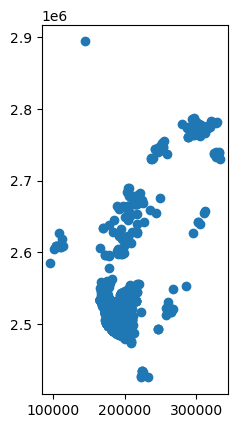

In [17]:
selected_ks_gdf.plot()

In [18]:
selected_ks_gdf['County_infected'].value_counts()

County_infected
Kaohsiung City    36936
Name: count, dtype: int64

In [19]:
# read the kaohsiung city boundary
geojson_file = './data/kaohsiung boundary/kaohsiung_city_boundary_new.geojson'
boundary_gdf = gpd.read_file(geojson_file)
boundary_gdf = boundary_gdf.to_crs(epsg=3826)

<Axes: >

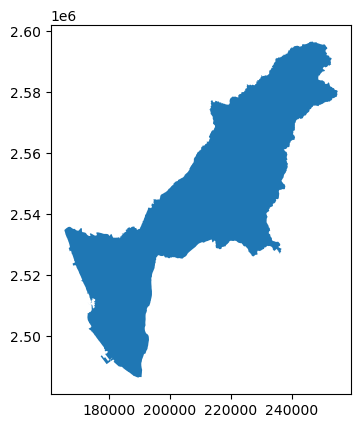

In [20]:
boundary_gdf.plot()

In [21]:
# get the dengue cases within the boundary only (use spatial join)
final_ks_gdf = gpd.sjoin(selected_ks_gdf, boundary_gdf, how='inner')

In [22]:
final_ks_gdf['County_infected'].value_counts()

County_infected
Kaohsiung City    36491
Name: count, dtype: int64

# EDA (Exploratory data analysis)

## Plot the population over the district

In [23]:
# read the administrative boundary data of Kaohsiung City (township level)
# the data has population of each township as well
ks_pop_gdf = gpd.read_file('./data/clipped_kaohsiung_pop_new.gpkg')

In [24]:
# set the crs of the data to EPSG:3826
ks_pop_gdf = ks_pop_gdf.to_crs(epsg=3826)

In [25]:
ks_pop_gdf.head()

,admin_level,osm_admin_level,name,name_en,population,hasc,geometry
0,10,7,大寮區,Daliao District,148765.0,None,"MULTIPOLYGON (((185061.651 2499414.373, 185062..."
1,10,7,旗山區,Qishan District,37032.0,None,"MULTIPOLYGON (((189988.867 2522937.679, 189993..."
2,10,7,美濃區,Meinong District,34087.0,None,"MULTIPOLYGON (((198210.323 2529428.951, 198233..."
3,10,7,內門區,Neimen District,12734.0,None,"MULTIPOLYGON (((189249.525 2534466.472, 189250..."
4,10,7,路竹區,Luzhu District,55030.0,None,"MULTIPOLYGON (((169273.789 2528012.539, 169412..."


<Axes: >

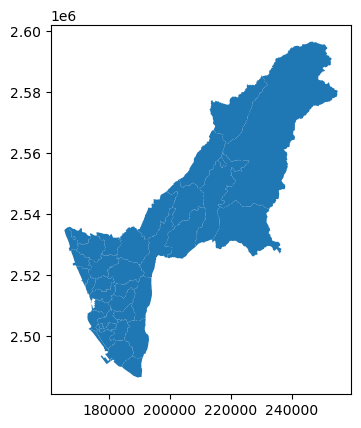

In [26]:
ks_pop_gdf.plot()

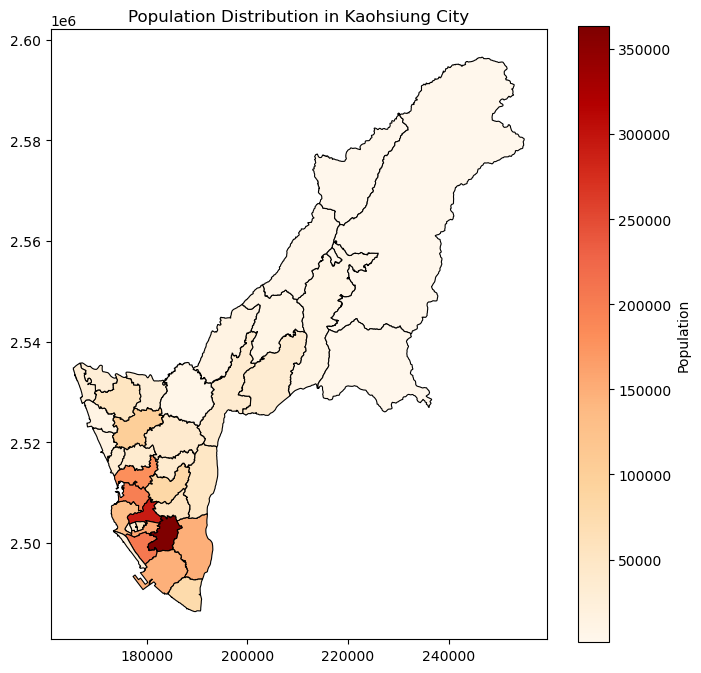

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
plot = ks_pop_gdf.plot(column='population', cmap='OrRd', linewidth=0.8, ax=ax, edgecolor='0', legend=True, )
# customize the colorbar
cbar = plot.get_figure().get_axes()[1]  # get the colorbar axis
cbar.set_ylabel('Population')
ax.set_title('Population Distribution in Kaohsiung City')
plt.show()

**Interactive version**

In [28]:
ks_pop_gdf_viz = ks_pop_gdf.copy()
ks_pop_gdf_viz = ks_pop_gdf_viz.to_crs(epsg=4326)
fig = px.choropleth_mapbox(ks_pop_gdf_viz,
                           geojson=ks_pop_gdf_viz.geometry,
                           locations=ks_pop_gdf.index,
                           color='population',
                           color_continuous_scale='OrRd',
                           mapbox_style="open-street-map",
                           zoom=8,
                           center={"lat": 22.6273, "lon": 120.3014},
                           title='Population in Kaohsiung City',
                           hover_data={'name_en': True, 'population': True})
fig.update_layout(coloraxis_colorbar=dict(title="Population"))
fig.show()

## Plot the number of cases grouped by year and month

In [29]:
# group the dengue cases data by year and month 
grouped_df = final_ks_gdf.groupby(['year_infected', 'month_infected']).size().reset_index(name='count')
# change the data type of year_infected to string
grouped_df['year_infected'] = grouped_df['year_infected'].astype(str)

# bar plot of dengue cases in Kaohsiung City by year and month
fig = px.histogram(grouped_df, x='year_infected', y='count', 
                   color='month_infected', barmode='group', 
                   title='Dengue cases in Kaohsiung City', 
                   category_orders={'month_infected': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]}).update_layout(legend_title='Month', xaxis_title='Year', yaxis_title='Number of cases')

fig.show()

In [195]:
final_ks_gdf.groupby('month_infected').size()

month_infected
1       423
2        21
3         9
4         6
5        33
6       126
7       403
8      1505
9      4476
10    10815
11    14167
12     4507
dtype: int64

## Plot cases in each year

In [30]:
final_ks_gdf.columns

Index(['Date_Onset', 'Date_Confirmation', 'Date_Notification', 'Sex',
       'Age_Group', 'County_living', 'Township_living', 'Village_Living',
       'Village_Living_Code', 'Enumeration_unit',
       ...
       'name:zh-Latn-tongyong', 'nat_ref', 'population', 'type', 'wikidata',
       'wikipedia', 'wikipedia:hak', 'wikipedia:nan', 'wikipedia:szy',
       'wikipedia:zh'],
      dtype='object', length=124)

In [31]:
# change the data type of Enumeration_unit_lat and Enumeration_unit_long to float
final_ks_gdf['Enumeration_unit_lat'] = final_ks_gdf['Enumeration_unit_lat'].astype(float)
final_ks_gdf['Enumeration_unit_long'] = final_ks_gdf['Enumeration_unit_long'].astype(float)

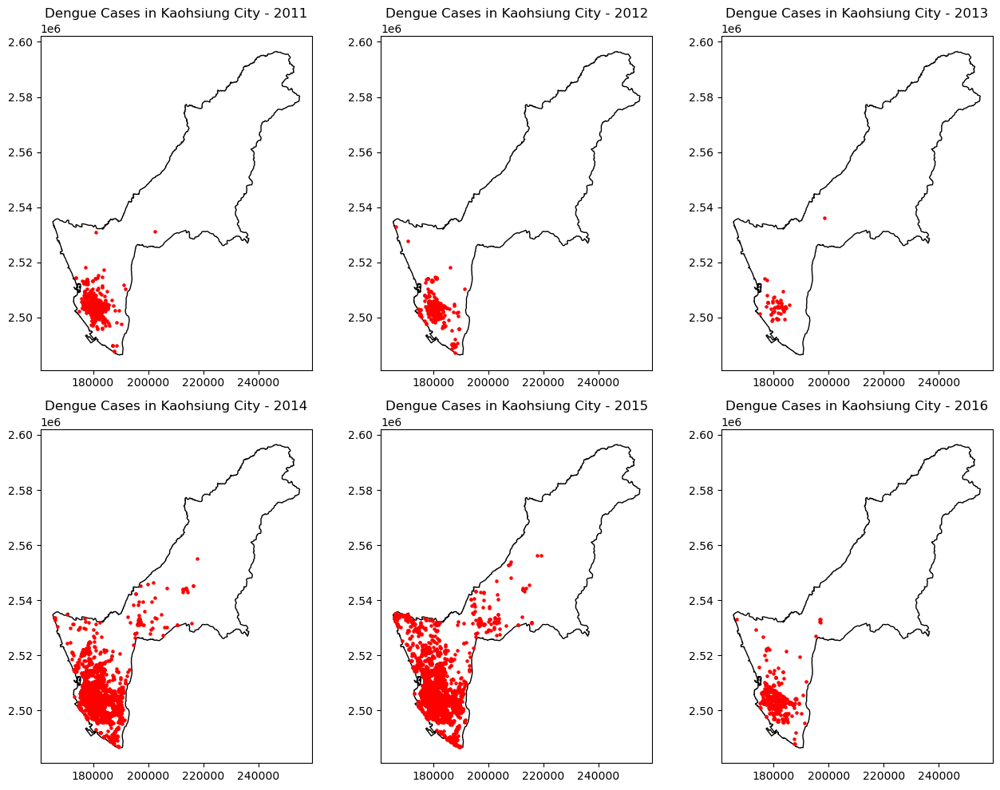

In [32]:
# get the unique year from the year_infected column
years = final_ks_gdf['year_infected'].unique()
# create a figure with 2 rows and 3 columns (subplots)
fig, axes = plt.subplots(2, 3, figsize=(13, 10))
# flatten the axes array (for easy iteration)
axes = axes.flatten()

# create a plot for each year
for i, year in enumerate(years):
    temp_gdf = final_ks_gdf[final_ks_gdf['year_infected'] == year]
    # plot the boundary and points
    boundary_gdf.plot(ax=axes[i], edgecolor='black', facecolor='none')
    temp_gdf.plot(ax=axes[i], marker='o', color='red', markersize=5)
    # set the title of the plot
    axes[i].set_title(f'Dengue Cases in Kaohsiung City - {year}')

plt.tight_layout()
plt.show()

## Check whether the cases are imported or not

In [33]:
final_ks_gdf.groupby('Imported').size()

Imported
N    36491
dtype: int64

All dengue cases in Kaohsiung is **Local** (No imported cases)

## Serotype

In [34]:
# group dengue cases data by serotype
serotype_df = final_ks_gdf.groupby('Serotype').size().reset_index(name='count')

In [35]:
serotype_df

,Serotype,count
0,DENV1,42
1,DENV2,740
2,DENV3,48
3,DENV4,6
4,None,35655


In [36]:
serotype_df_new = serotype_df[serotype_df['Serotype'] != 'None']

In [37]:
# plot dengue cases by serotype
fig = px.bar(serotype_df_new, x='Serotype', y='count', title='Dengue Cases by Serotype')
fig.show()

# Part 1: Demographics profiles of vulnerable groups of Dengue

In [38]:
final_ks_gdf['Age_Group'].unique()

array(['35-39', '40-44', '45-49', '10-14', '70+', '15-19', '50-54',
       '65-69', '60-64', '25-29', '55-59', '5-9', '30-34', '20-24', '3',
       '4', '0', '2', '1'], dtype=object)

In [39]:
# group age 0, 1, 2, 3, and 4 to 0-4 group
final_ks_gdf.loc[(final_ks_gdf['Age_Group'] == '0')|
                 (final_ks_gdf['Age_Group'] == '1')|
                 (final_ks_gdf['Age_Group'] == '2')|
                 (final_ks_gdf['Age_Group'] == '3')|
                 (final_ks_gdf['Age_Group'] == '4'),'Age_Group'] = '0-4'

In [40]:
final_ks_gdf['Age_Group'].unique()

array(['35-39', '40-44', '45-49', '10-14', '70+', '15-19', '50-54',
       '65-69', '60-64', '25-29', '55-59', '5-9', '30-34', '20-24', '0-4'],
      dtype=object)

In [41]:
# group the dengue cases by gender and age group
vul_group = final_ks_gdf.groupby(['Age_Group', 'Sex']).size().reset_index(name='count')

In [42]:
vul_group.head()

,Age_Group,Sex,count
0,0-4,F,213
1,0-4,M,247
2,10-14,F,643
3,10-14,M,935
4,15-19,F,805


In [43]:
gender_group = vul_group.groupby('Sex').sum().reset_index().drop(columns='Age_Group')

In [44]:
gender_group

,Sex,count
0,F,18396
1,M,18095


In [45]:
# # plot dengue cases by gender
# fig = px.bar(gender_group, x='Sex', y='count', title='Dengue Cases by Gender')
# fig.show()

In [46]:
age_group_case = vul_group.groupby('Age_Group').sum().reset_index()

In [47]:
age_group_case = age_group_case.drop(columns=['Sex'])
age_group_case

,Age_Group,count
0,0-4,460
1,10-14,1578
2,15-19,2031
3,20-24,2183
4,25-29,2143
5,30-34,2523
6,35-39,2791
7,40-44,2542
8,45-49,2631
9,5-9,995


In [48]:
category_orders = {
    'Age_Group': ['0-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70+']
}

# plot dengue cases by gender and age group
fig = px.bar(age_group_case, x='Age_Group', y='count', 
             category_orders=category_orders,
             title='Dengue Cases by Age Group')

fig.show()

In [49]:
color_scheme = {
    'M': 'cadetblue',
    'F': 'darksalmon'
}

category_orders = {
    'Age_Group': ['0-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70+']
}

# plot dengue cases by gender and age group
fig = px.bar(vul_group, x='Age_Group', y='count', color='Sex', 
             barmode='group',
             color_discrete_map=color_scheme,
             category_orders=category_orders,
             title='Dengue Cases by Age Group and Gender')

fig.show()

# Part 2: Spatio-temporal trend map of Dengue hotspots in Kaohsiung City, Taiwan (Hotspot Analysis)

## Aggregate data into district level (yearly)

In [50]:
# group the dengue cases data by town and year
group_district_df = final_ks_gdf.groupby(['Township_infected', 'year_infected']).size().reset_index(name='count')

In [51]:
group_district_df

,Township_infected,year_infected,count
0,Alian Dist.,2011,1
1,Alian Dist.,2014,7
2,Alian Dist.,2015,60
3,Daliao Dist.,2011,4
4,Daliao Dist.,2012,10
...,...,...,...
141,Zuoying Dist.,2011,38
142,Zuoying Dist.,2012,12
143,Zuoying Dist.,2014,886
144,Zuoying Dist.,2015,1273


In [52]:
# replace the word 'Dist.' with 'District' so it can be merges with administrative boundary data
group_district_df['Township_infected'] = group_district_df['Township_infected'].str.replace('Dist.', 'District')

In [53]:
group_district_df.head()

,Township_infected,year_infected,count
0,Alian District,2011,1
1,Alian District,2014,7
2,Alian District,2015,60
3,Daliao District,2011,4
4,Daliao District,2012,10


In [54]:
# list of unique years
years = group_district_df['year_infected'].unique()

# create a DataFrame with all combinations of townships and years
district_year_df = pd.DataFrame([(name, year) for name in ks_pop_gdf['name_en'] for year in years], columns=['name_en', 'year_infected'])

# merge the expanded DataFrame with the population data
district_year_df  = district_year_df .merge(ks_pop_gdf, on='name_en', how='left')

In [55]:
# merge the dengue cases data with the administrative boundary data
ks_analysis_gdf = district_year_df.merge(group_district_df, left_on=['name_en', 'year_infected'], right_on=['Township_infected', 'year_infected'], how='left')
# convert df to gdf
ks_analysis_gdf = gpd.GeoDataFrame(ks_analysis_gdf, geometry='geometry')
# fill the NaN values with 0
ks_analysis_gdf['count'] = ks_analysis_gdf['count'].fillna(0)

In [56]:
print(len(ks_analysis_gdf[ks_analysis_gdf['year_infected']==2014]['Township_infected'].unique().tolist()))
print(len(ks_analysis_gdf[ks_analysis_gdf['year_infected']==2015]['Township_infected'].unique().tolist()))
print(len(ks_analysis_gdf[ks_analysis_gdf['year_infected']==2016]['Township_infected'].unique().tolist()))

34
36
24


In [57]:
ks_analysis_gdf.columns

Index(['name_en', 'year_infected', 'admin_level', 'osm_admin_level', 'name',
       'population', 'hasc', 'geometry', 'Township_infected', 'count'],
      dtype='object')

In [58]:
ks_analysis_gdf[ks_analysis_gdf['count']==0]

,name_en,year_infected,admin_level,osm_admin_level,name,population,hasc,geometry,Township_infected,count
5,Daliao District,2013,10,7,大寮區,148765.0,None,"MULTIPOLYGON (((185061.651 2499414.373, 185062...",NaN,0.0
6,Qishan District,2011,10,7,旗山區,37032.0,None,"MULTIPOLYGON (((189988.867 2522937.679, 189993...",NaN,0.0
9,Qishan District,2012,10,7,旗山區,37032.0,None,"MULTIPOLYGON (((189988.867 2522937.679, 189993...",NaN,0.0
11,Qishan District,2013,10,7,旗山區,37032.0,None,"MULTIPOLYGON (((189988.867 2522937.679, 189993...",NaN,0.0
15,Meinong District,2012,10,7,美濃區,34087.0,None,"MULTIPOLYGON (((198210.323 2529428.951, 198233...",NaN,0.0
...,...,...,...,...,...,...,...,...,...,...
213,Tianliao District,2012,10,7,田寮區,6325.0,None,"MULTIPOLYGON (((182472.899 2525453.013, 182494...",NaN,0.0
214,Tianliao District,2016,10,7,田寮區,6325.0,None,"MULTIPOLYGON (((182472.899 2525453.013, 182494...",NaN,0.0
215,Tianliao District,2013,10,7,田寮區,6325.0,None,"MULTIPOLYGON (((182472.899 2525453.013, 182494...",NaN,0.0
221,Dashu District,2013,10,7,大樹區,49938.0,None,"MULTIPOLYGON (((187299.102 2509568.78, 187308....",NaN,0.0


In [59]:
# calculate the dengue incidence rate
ks_analysis_gdf['dengue_rate'] = (ks_analysis_gdf['count'] / ks_analysis_gdf['population'])*100

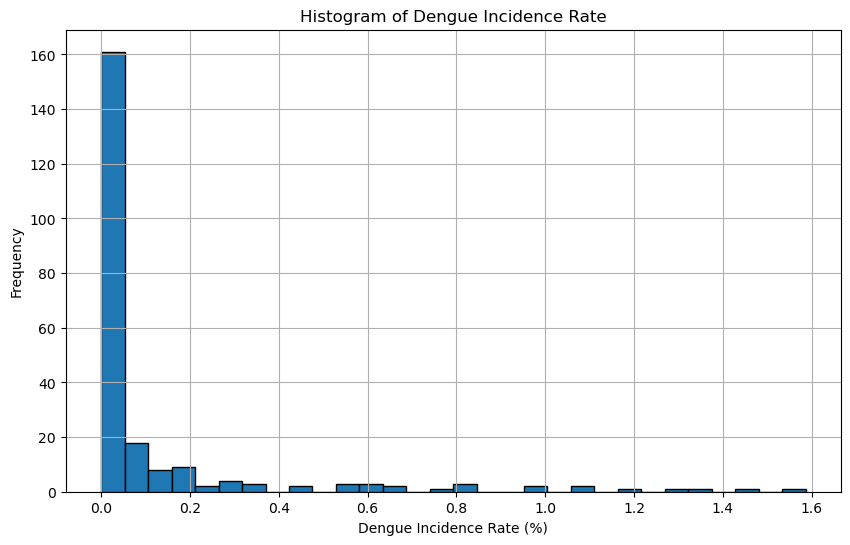

In [60]:
plt.figure(figsize=(10, 6))
plt.hist(ks_analysis_gdf['dengue_rate'], bins=30, edgecolor='black')
plt.title('Histogram of Dengue Incidence Rate')
plt.xlabel('Dengue Incidence Rate (%)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

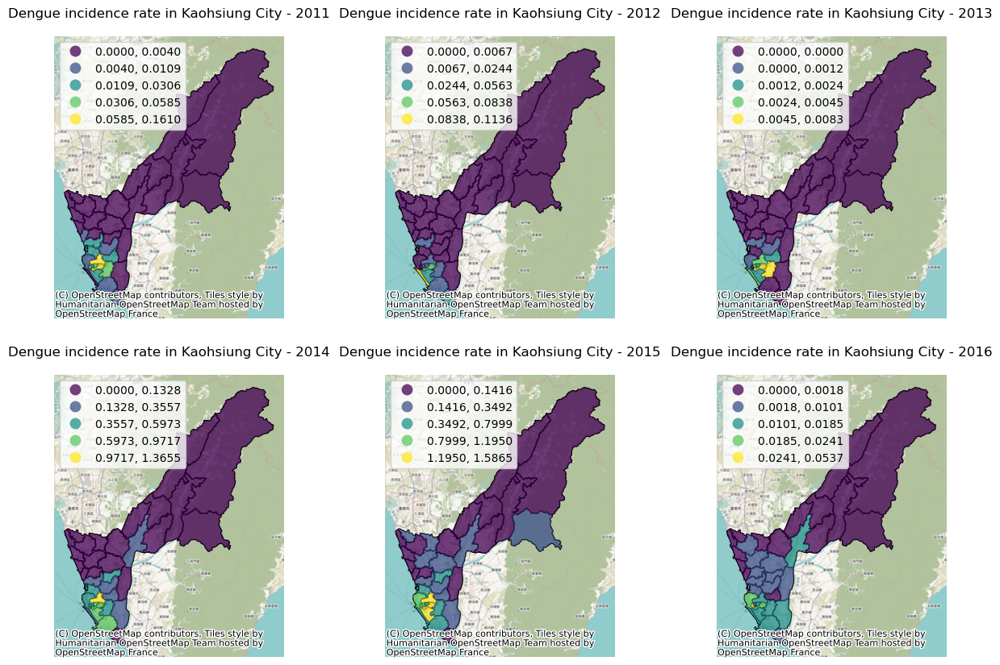

In [61]:
# create a figure with 2 rows and 3 columns (subplots)
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()
# sort the years
years = sorted(ks_analysis_gdf['year_infected'].unique())

for i, year in enumerate(years):
    temp_gdf = ks_analysis_gdf[ks_analysis_gdf['year_infected'] == year]
    # plot the boundary and points
    ks_pop_gdf.plot(ax=axes[i], edgecolor='black', facecolor='none')
    temp_gdf.plot(ax=axes[i], 
                  column='dengue_rate', 
                  cmap='viridis', 
                  scheme='NaturalBreaks', 
                  k=5, 
                  edgecolor='black', 
                  linewidth=0.0, 
                  alpha=0.75, 
                  legend=True, 
                  legend_kwds={"loc": "upper left", "fmt": "{:.4f}"})
    axes[i].set_title(f'Dengue incidence rate in Kaohsiung City - {year}')
    # add basemap
    ctx.add_basemap(
        axes[i],
        crs=ks_analysis_gdf.crs
    )
    # turn off the axis lines, ticks, and labels
    axes[i].set_axis_off()

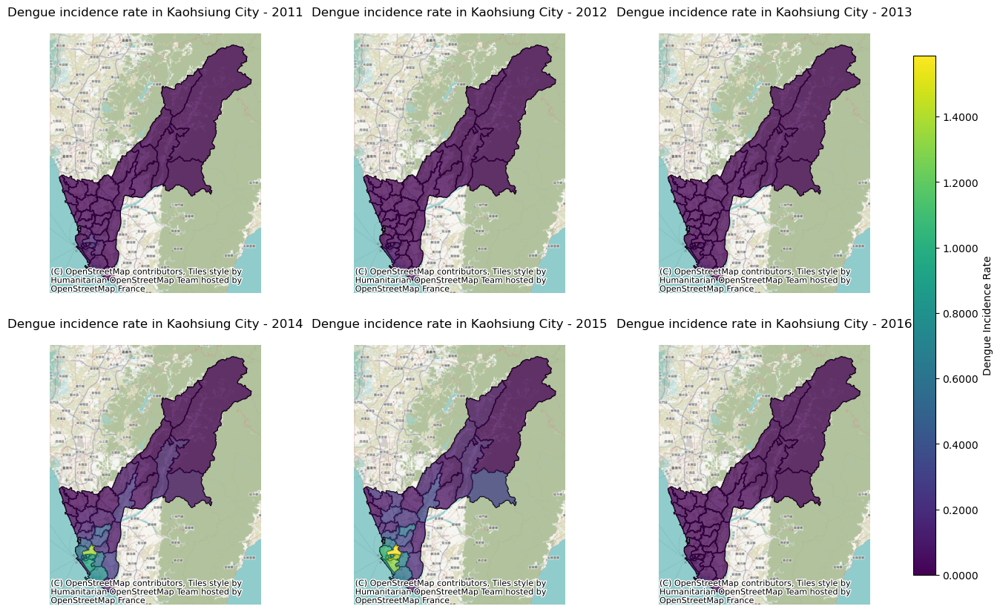

In [ ]:
# Calculate global min/max for consistent scale
vmin = ks_analysis_gdf['dengue_rate'].min()
vmax = ks_analysis_gdf['dengue_rate'].max()

# create a figure with 2 rows and 3 columns (subplots)
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()
# sort the years
years = sorted(ks_analysis_gdf['year_infected'].unique())

# create common scale colorbar
norm = plt.Normalize(vmin=vmin, vmax=vmax)
sm = plt.cm.ScalarMappable(norm=norm, cmap='viridis')

for i, year in enumerate(years):
    temp_gdf = ks_analysis_gdf[ks_analysis_gdf['year_infected'] == year]
    # plot the boundary and points
    ks_pop_gdf.plot(ax=axes[i], edgecolor='black', facecolor='none')
    temp_gdf.plot(ax=axes[i], 
                  column='dengue_rate', 
                  cmap='viridis',
                  vmin=vmin,
                  vmax=vmax,
                  edgecolor='black', 
                  linewidth=0.0, 
                  alpha=0.75, 
                  legend=False)
    axes[i].set_title(f'Dengue incidence rate in Kaohsiung City - {year}')
    # add basemap
    ctx.add_basemap(
        axes[i],
        crs=ks_analysis_gdf.crs
    )
    # turn off the axis lines, ticks, and labels
    axes[i].set_axis_off()

# add colorbar to figure
cax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
plt.colorbar(sm, cax=cax, format='%.4f', label='Dengue Incidence Rate')

plt.show()

In [63]:
def assign_range(row, q_list, min_rate):
    if row['dengue_rate'] <= q_list[0]:
        return f'{min_rate:.4f} - {q_list[0]:.4f}'
    elif row['dengue_rate'] <= q_list[1]:
        return f'{q_list[0]:.4f} - {q_list[1]:.4f}'
    elif row['dengue_rate'] <= q_list[2]:
        return f'{q_list[1]:.4f} - {q_list[2]:.4f}'
    elif row['dengue_rate'] <= q_list[3]:
        return f'{q_list[2]:.4f} - {q_list[3]:.4f}'
    else:
        return f'> {q_list[3]:.4f}'

In [64]:
# def assign_color_scheme(row, q_list):
#     if row['dengue_rate'] <= q_list[0]:
#         return 0
#     elif row['dengue_rate'] <= q_list[1]:
#         return 1
#     elif row['dengue_rate'] <= q_list[2]:
#         return 2
#     elif row['dengue_rate'] <= q_list[3]:
#         return 3
#     else:
#         return 4

In [65]:
for i, year in enumerate(years):
    temp_gdf = ks_analysis_gdf[ks_analysis_gdf['year_infected'] == year]
    temp_q = mapclassify.Quantiles(temp_gdf['dengue_rate'], k=5)
    ks_analysis_gdf.loc[ks_analysis_gdf['year_infected'] == year, 'q_class'] = temp_gdf.apply(assign_range, q_list=temp_q.bins, min_rate=temp_gdf['dengue_rate'].min(), axis=1)
    # ks_analysis_gdf.loc[ks_analysis_gdf['year_infected'] == year, 'q_class_no'] = temp_gdf.apply(assign_color_scheme, q_list=temp_q.bins, axis=1)

/root/miniforge3/envs/geohealth/lib/python3.12/site-packages/mapclassify/classifiers.py:1653: UserWarning:

Not enough unique values in array to form 5 classes. Setting k to 4.

/root/miniforge3/envs/geohealth/lib/python3.12/site-packages/mapclassify/classifiers.py:1653: UserWarning:

Not enough unique values in array to form 5 classes. Setting k to 4.

/root/miniforge3/envs/geohealth/lib/python3.12/site-packages/mapclassify/classifiers.py:1653: UserWarning:

Not enough unique values in array to form 5 classes. Setting k to 3.



In [66]:
# to make sure that the plot can be rendered in Jupyter Notebook
import plotly.io as pio
pio.renderers.default = 'notebook'

In [67]:
# # Create a discrete color map from the Viridis color scale
# # viridis_colors = plotly.colors.sequential.Viridis
# # discrete_color_map = {str(i): viridis_colors[i * (len(viridis_colors) // 5)] for i in range(5)}
# # Define custom labels for the q_class values
# # custom_labels = {
# #     '0': 'Very Low',
# #     '1': 'Low',
# #     '2': 'Medium',
# #     '3': 'High',
# #     '4': 'Very High'
# # }

# # plot the dengue incidence rate in Kaohsiung City from 2011 to 2016
# test_gdf = ks_analysis_gdf.to_crs(epsg=4326).set_index('name_en')
# test_gdf = test_gdf.sort_values(by=['year_infected', 'q_class'])
# # test_gdf['q_class_no'] = test_gdf['q_class_no'].astype(int).astype(str)
# # print(test_gdf['q_class_no'].unique())
# fig = px.choropleth_map(test_gdf,
#                         geojson=test_gdf.geometry,
#                         locations=test_gdf.index,
#                         color="dengue_rate",
#                         color_continuous_scale='Viridis',
#                         labels={'dengue_rate': 'Dengue Incidence Rate (%)'},
#                         map_style="open-street-map",
#                         zoom=8, 
#                         animation_frame='year_infected',
#                         center={"lat": 22.6273, "lon": 120.3014},
#                         title='Dengue incidence rate in Kaohsiung City from 2011 to 2016')

# # # Update the legend labels for each frame
# # for frame in fig.frames:
# #     for trace in frame.data:
# #         trace.name = custom_labels[trace.name]

# # # Update the legend labels for the initial traces
# # for trace in fig.data:
# #     trace.name = custom_labels[trace.name]
# #     trace.colorbar = 'viridis'
    
# fig.show()

In [68]:
# f, ax = plt.subplots(1, figsize=(9, 9))

# ks_pop_gdf.plot(ax=ax, edgecolor='black', facecolor='none')

# # Build choropleth
# ks_analysis_gdf[(ks_analysis_gdf['year_infected'] == 2012)].plot(
#     column="dengue_rate",
#     cmap="viridis",
#     scheme="quantiles",
#     k=5,
#     edgecolor="white",
#     linewidth=0.0,
#     alpha=0.75,
#     legend=True,
#     legend_kwds={"loc": "upper left", "fmt": "{:.6f}"},
#     ax=ax,
# )
# # Add basemap
# ctx.add_basemap(
#     ax,
#     crs=ks_analysis_gdf.crs
# )
# # Remove axes
# ax.set_axis_off()

## Aggregate data into district level (monthly)

In [69]:
# group the dengue cases data by town and month and sort the data by month
group_district_monthly_df = final_ks_gdf.groupby(['Township_infected', 'month_infected']).size().reset_index(name='count').sort_values(by=['month_infected'])
# replace the word 'Dist.' with 'District' so it can be merges with administrative boundary data
group_district_monthly_df['Township_infected'] = group_district_monthly_df['Township_infected'].str.replace('Dist.', 'District')

In [70]:
# list of unique months
months = group_district_monthly_df['month_infected'].unique()

# create a DataFrame with all combinations of townships and years
district_month_df = pd.DataFrame([(name, month) for name in ks_pop_gdf['name_en'] for month in months], columns=['name_en', 'month_infected'])

# merge the expanded DataFrame with the population data
district_month_df  = district_month_df .merge(ks_pop_gdf, on='name_en', how='left')

In [71]:
# merge the dengue cases data with the administrative boundary data
ks_analysis_monthly_gdf = district_month_df.merge(group_district_monthly_df, left_on=['name_en', 'month_infected'], right_on=['Township_infected', 'month_infected'], how='left')
# convert df to gdf
ks_analysis_monthly_gdf = gpd.GeoDataFrame(ks_analysis_monthly_gdf, geometry='geometry')
# fill the NaN values with 0
ks_analysis_monthly_gdf['count'] = ks_analysis_monthly_gdf['count'].fillna(0)

In [72]:
# # merge the dengue cases data with the administrative boundary data
# ks_analysis_monthly_gdf = ks_pop_gdf.merge(group_district_monthly_df, left_on='name_en', right_on='Township_infected')
# # fill the NaN values with 0
# ks_analysis_monthly_gdf['count'] = ks_analysis_monthly_gdf['count'].fillna(0)

In [73]:
# calculate the dengue incidence rate
ks_analysis_monthly_gdf['dengue_rate'] = (ks_analysis_monthly_gdf['count'] / ks_analysis_monthly_gdf['population'])*100

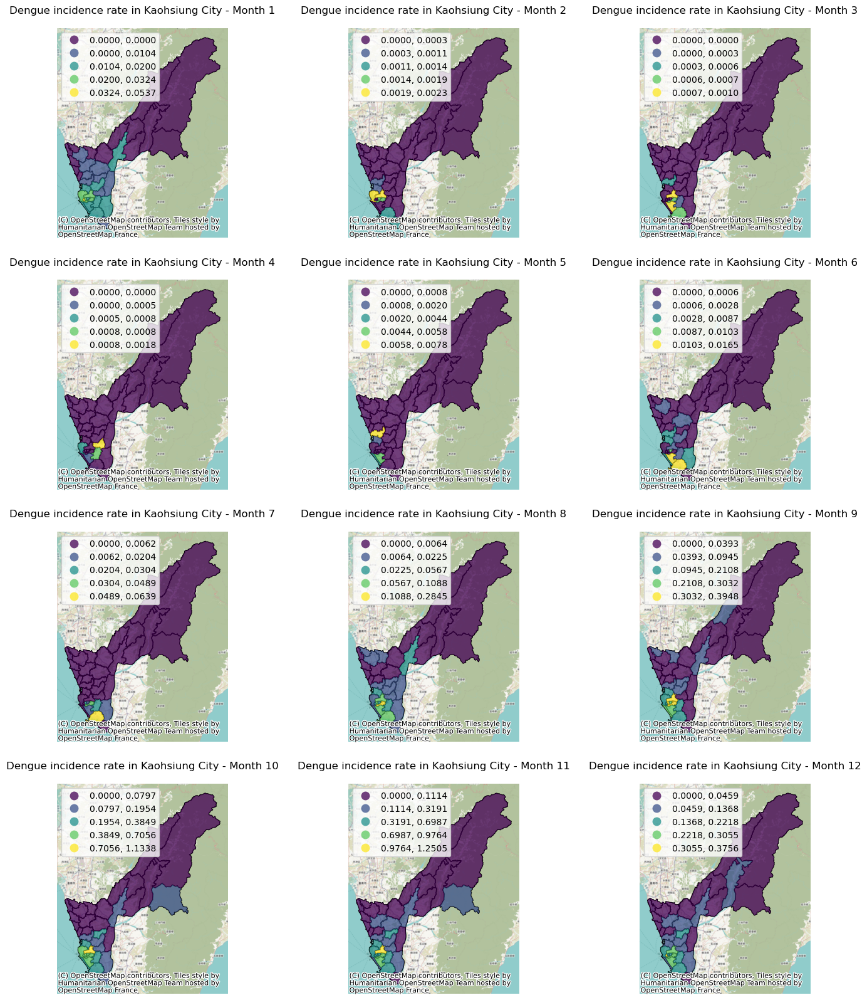

In [74]:
# create a figure with 2 rows and 3 columns (subplots)
fig, axes = plt.subplots(4, 3, figsize=(17, 20))
axes = axes.flatten()
# sort the months
months = sorted(ks_analysis_monthly_gdf['month_infected'].unique())

for i, year in enumerate(months):
    temp_gdf = ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == year]
    # plot the boundary and points
    ks_pop_gdf.plot(ax=axes[i], edgecolor='black', facecolor='none')
    temp_gdf.plot(ax=axes[i], 
                  column='dengue_rate', 
                  cmap='viridis', 
                  scheme='NaturalBreaks', 
                  k=5, 
                  edgecolor='black', 
                  linewidth=0.0, 
                  alpha=0.75, 
                  legend=True, 
                  legend_kwds={"loc": "upper left", "fmt": "{:.4f}"})
    axes[i].set_title(f'Dengue incidence rate in Kaohsiung City - Month {year}')
    # add basemap
    ctx.add_basemap(
        axes[i],
        crs=ks_analysis_monthly_gdf.crs
    )
    # turn off the axis lines, ticks, and labels
    axes[i].set_axis_off()

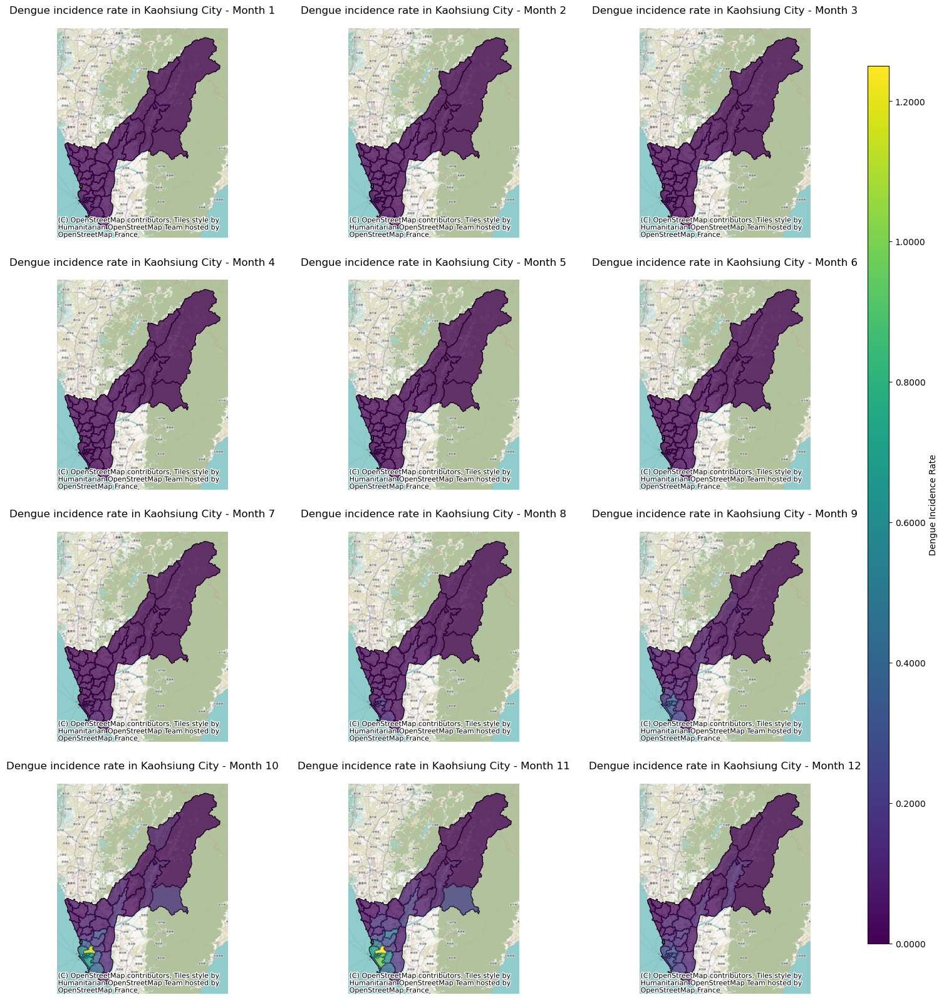

In [ ]:
vmin = ks_analysis_monthly_gdf['dengue_rate'].min()
vmax = ks_analysis_monthly_gdf['dengue_rate'].max()

# create a figure with 2 rows and 3 columns (subplots)
fig, axes = plt.subplots(4, 3, figsize=(17, 20))
axes = axes.flatten()
# sort the months
months = sorted(ks_analysis_monthly_gdf['month_infected'].unique())

# create common scale colorbar
norm = plt.Normalize(vmin=vmin, vmax=vmax)
sm = plt.cm.ScalarMappable(norm=norm, cmap='viridis')

for i, year in enumerate(months):
    temp_gdf = ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == year]
    # plot the boundary and points
    ks_pop_gdf.plot(ax=axes[i], edgecolor='black', facecolor='none')
    temp_gdf.plot(ax=axes[i], 
                  column='dengue_rate', 
                  cmap='viridis', 
                  vmin=vmin,
                  vmax=vmax,
                  edgecolor='black', 
                  linewidth=0.0, 
                  alpha=0.75, 
                  legend=False)
    axes[i].set_title(f'Dengue incidence rate in Kaohsiung City - Month {year}')
    # add basemap
    ctx.add_basemap(
        axes[i],
        crs=ks_analysis_monthly_gdf.crs
    )
    # turn off the axis lines, ticks, and labels
    axes[i].set_axis_off()

# add colorbar to figure
cax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
plt.colorbar(sm, cax=cax, format='%.4f', label='Dengue Incidence Rate')

plt.show()

### This part can be uncommented to plot the interactive map
I commented this part because the file is too heavy

In [76]:
# for i, year in enumerate(months):
#     temp_gdf = ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == year]
#     temp_q = mapclassify.Quantiles(temp_gdf['dengue_rate'], k=5)
#     ks_analysis_monthly_gdf.loc[ks_analysis_monthly_gdf['month_infected'] == year, 'q_class'] = temp_gdf.apply(assign_range, q_list=temp_q.bins, min_rate=temp_gdf['dengue_rate'].min(), axis=1)
#     # ks_analysis_gdf.loc[ks_analysis_gdf['year_infected'] == year, 'q_class_no'] = temp_gdf.apply(assign_color_scheme, q_list=temp_q.bins, axis=1)

In [77]:
# # plot the dengue incidence rate in Kaohsiung City (monthly)
# test_gdf = ks_analysis_monthly_gdf.to_crs(epsg=4326).set_index('name_en')
# test_gdf = test_gdf.sort_values(by=['month_infected','q_class'])
# fig = px.choropleth_map(test_gdf,
#                         geojson=test_gdf.geometry,
#                         locations=test_gdf.index,
#                         color="q_class",
#                         labels={'q_class': 'Dengue Incidence Rate (%)'},
#                         map_style="open-street-map",
#                         zoom=8, 
#                         animation_frame='month_infected',
#                         center={"lat": 22.6273, "lon": 120.3014},
#                         title='Dengue incidence rate in Kaohsiung City (monthly)')
# fig.show()

## Moran's I (yearly)

### Contiguity based (Queen contiguity)

#### Global Moran's I

In [78]:
# sort the year
year_list = sorted(ks_analysis_gdf['year_infected'].unique())

/tmp/ipykernel_965/2783932777.py:3: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9

Year: 2011
Moran's I for 2011: 0.4148210395576743
Moran's I p-value for 2011: 0.003



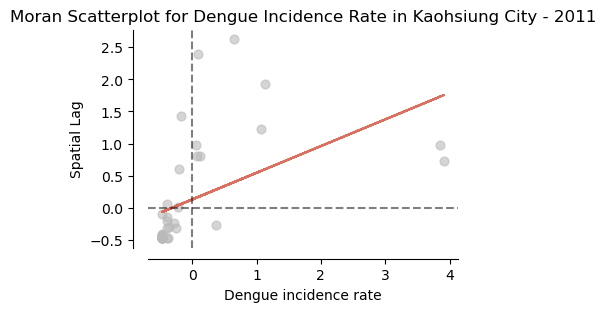

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9

Year: 2012
Moran's I for 2012: 0.23343443003570288
Moran's I p-value for 2012: 0.01



/tmp/ipykernel_965/2783932777.py:3: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



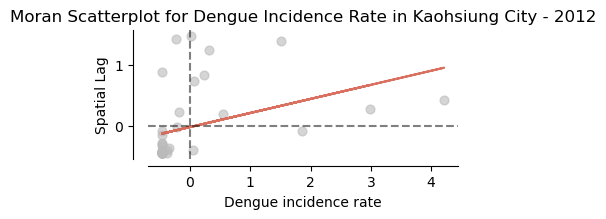

/tmp/ipykernel_965/2783932777.py:3: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9

Year: 2013
Moran's I for 2013: 0.3998668496811851
Moran's I p-value for 2013: 0.002



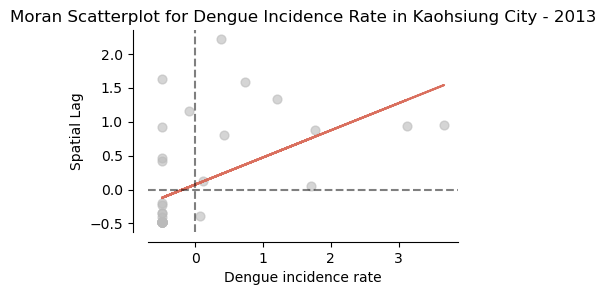

/tmp/ipykernel_965/2783932777.py:3: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9

Year: 2014
Moran's I for 2014: 0.6922593675685506
Moran's I p-value for 2014: 0.001



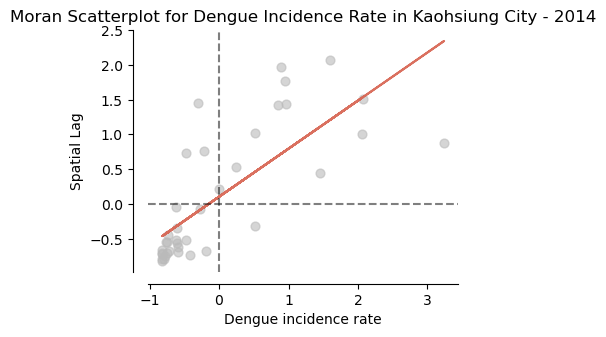

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9

Year: 2015
Moran's I for 2015: 0.7946599954064679
Moran's I p-value for 2015: 0.001



/tmp/ipykernel_965/2783932777.py:3: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



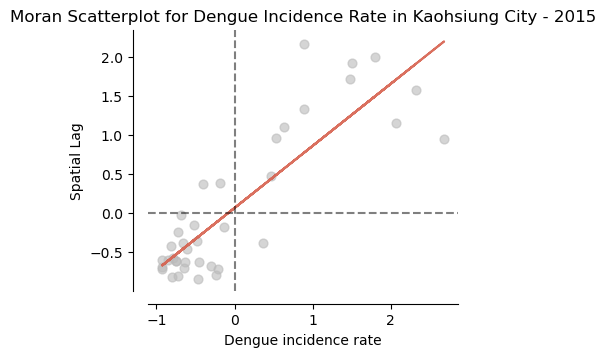

/tmp/ipykernel_965/2783932777.py:3: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9

Year: 2016
Moran's I for 2016: 0.5076931376434877
Moran's I p-value for 2016: 0.001



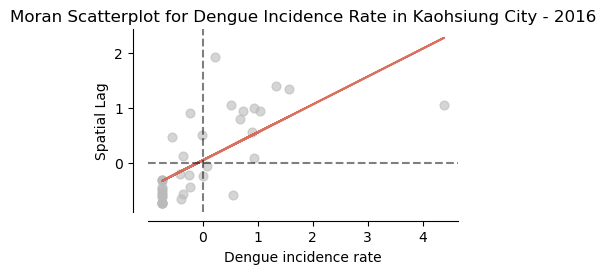

In [ ]:
for i in year_list:
    # create a spatial weights matrix
    w = Queen.from_dataframe(ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i])
    w.transform = 'r'
    
    print("neighbour value:", w.neighbors.values())
    # calculate number of neighbors for each area
    n_neighbors = pd.Series([len(neighbors) for neighbors in w.neighbors.values()], 
                        index=w.neighbors.keys())

    # Calculate statistics
    mean_neighbors = n_neighbors.mean()
    min_neighbors = n_neighbors.min()
    max_neighbors = n_neighbors.max()

    print(f"Mean number of neighbors: {mean_neighbors:.2f}")
    print(f"Min number of neighbors: {min_neighbors}")
    print(f"Max number of neighbors: {max_neighbors}")
    # print("\nNumber of neighbors distribution:")
    # print(n_neighbors.value_counts().sort_index())

    # calculate Moran's I
    mi = esda.Moran(ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i]['dengue_rate'], w)
    
    print()
    print('Year:', i)
    print(f"Moran's I for {i}: {mi.I}")
    print(f"Moran's I p-value for {i}: {mi.p_sim}\n")

    fig, ax = plt.subplots(1, figsize=(4, 4))
    moran_scatterplot(mi, ax=ax)
    ax.set_title(f'Moran Scatterplot for Dengue Incidence Rate in Kaohsiung City - {i}')
    ax.set_xlabel('Dengue incidence rate')
    ax.set_ylabel('Spatial Lag')
    plt.show()

### Local Moran's I

/tmp/ipykernel_965/2043889744.py:4: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



Year: 2011
[0.329 0.035 0.08  0.069 0.024 0.001 0.198 0.024 0.176 0.022 0.022 0.024
 0.176 0.024 0.005 0.003 0.06  0.308 0.453 0.001 0.001 0.001 0.001 0.046
 0.379 0.335 0.004 0.173 0.064 0.041 0.075 0.47  0.025 0.182 0.436 0.044
 0.252 0.492]
[2 3 3 3 3 3 3 3 3 3 3 3 3 3 1 2 1 4 3 1 1 1 1 1 3 2 1 3 3 1 2 3 3 3 3 3 3
 3]
number of hotspot: 8


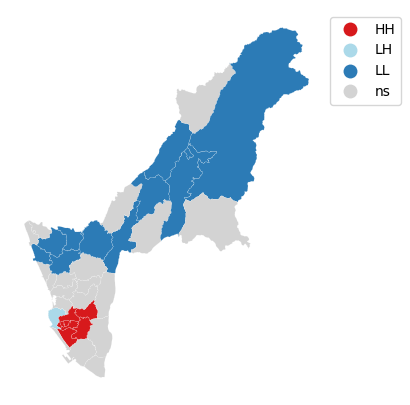

/tmp/ipykernel_965/2043889744.py:4: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



Year: 2012
[0.261 0.068 0.001 0.001 0.059 0.196 0.001 0.121 0.359 0.045 0.045 0.001
 0.001 0.001 0.075 0.001 0.371 0.135 0.379 0.24  0.069 0.162 0.042 0.003
 0.12  0.005 0.043 0.001 0.211 0.447 0.447 0.389 0.021 0.12  0.321 0.07
 0.115 0.276]
[2 3 3 3 3 3 3 3 3 3 3 3 3 3 2 2 3 4 3 1 1 1 1 1 1 1 1 3 3 3 3 3 3 3 3 3 3
 4]
number of hotspot: 4


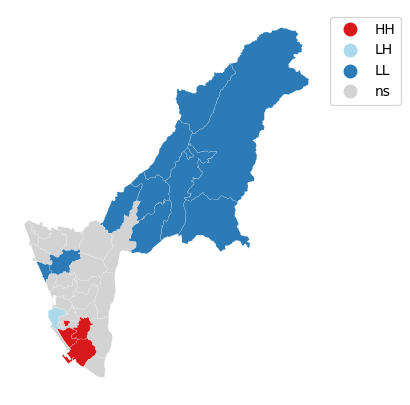

/tmp/ipykernel_965/2043889744.py:4: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



Year: 2013
[0.187 0.1   0.346 0.346 0.153 0.346 0.346 0.232 0.492 0.153 0.153 0.232
 0.492 0.232 0.003 0.009 0.191 0.208 0.301 0.002 0.016 0.002 0.002 0.002
 0.302 0.032 0.007 0.5   0.352 0.033 0.315 0.453 0.035 0.11  0.306 0.143
 0.34  0.498]
[2 3 3 3 3 3 3 3 3 3 3 3 3 3 2 2 2 4 3 1 1 1 1 1 1 2 1 3 3 1 1 3 3 3 3 3 3
 3]
number of hotspot: 7


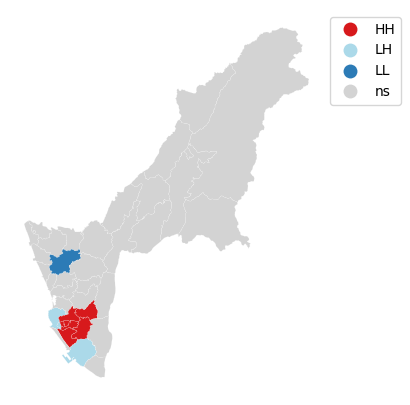

/tmp/ipykernel_965/2043889744.py:4: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



Year: 2014
[0.332 0.009 0.221 0.152 0.004 0.048 0.074 0.015 0.03  0.084 0.008 0.021
 0.014 0.036 0.001 0.001 0.038 0.408 0.123 0.001 0.001 0.001 0.004 0.015
 0.015 0.14  0.002 0.21  0.006 0.054 0.103 0.291 0.003 0.148 0.147 0.092
 0.465 0.157]
[2 3 3 3 3 3 3 3 3 3 3 3 3 3 1 1 1 3 3 1 1 1 1 1 2 1 1 3 3 2 1 4 3 3 3 3 3
 2]
number of hotspot: 9


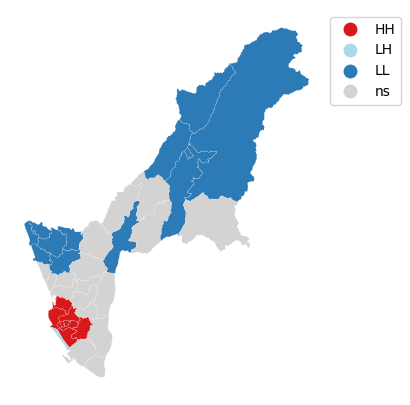

/tmp/ipykernel_965/2043889744.py:4: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



Year: 2015
[0.363 0.013 0.178 0.128 0.055 0.137 0.14  0.04  0.025 0.058 0.024 0.004
 0.04  0.095 0.001 0.001 0.042 0.299 0.233 0.001 0.001 0.001 0.001 0.003
 0.018 0.138 0.003 0.068 0.048 0.211 0.159 0.24  0.005 0.127 0.17  0.161
 0.246 0.461]
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 1 1 1 3 3 1 1 1 1 1 1 1 1 3 3 2 2 4 3 3 3 3 3
 3]
number of hotspot: 10


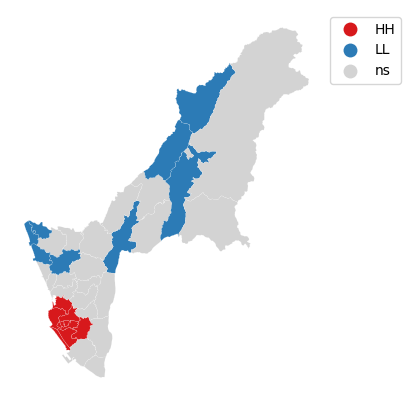

/tmp/ipykernel_965/2043889744.py:4: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



Year: 2016
[0.306 0.033 0.315 0.315 0.026 0.162 0.108 0.082 0.181 0.103 0.001 0.02
 0.131 0.02  0.002 0.001 0.138 0.336 0.157 0.001 0.001 0.001 0.084 0.023
 0.072 0.106 0.04  0.136 0.09  0.143 0.459 0.355 0.016 0.284 0.155 0.229
 0.296 0.092]
[1 4 3 3 3 3 3 3 3 3 3 3 3 3 1 1 2 3 3 1 1 1 1 1 1 1 1 3 3 2 4 3 3 3 3 3 2
 2]
number of hotspot: 7


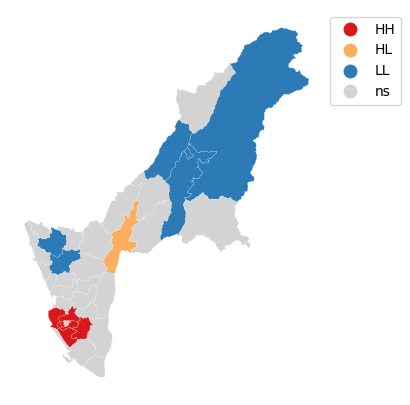

In [ ]:
# calculate Moran_Local and plot
for i in year_list:
    # create a spatial weights matrix
    w = Queen.from_dataframe(ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i])
    w.transform = 'r'
    print('Year:', i)
    # calculate Moran's I    
    moran_loc = Moran_Local(ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i]['dengue_rate'], w)
    town_temp_list = ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i]['name_en'].to_list()
    print(moran_loc.p_sim)
    print(moran_loc.q)
    for j in range(len(moran_loc.q)):
        if moran_loc.p_sim[j] < 0.05:
            ks_analysis_gdf.loc[(ks_analysis_gdf['year_infected'] == i) & (ks_analysis_gdf['name_en'] == town_temp_list[j]), 'moran_q_queen'] = moran_loc.q[j]
        else:
            ks_analysis_gdf.loc[(ks_analysis_gdf['year_infected'] == i) & (ks_analysis_gdf['name_en'] == town_temp_list[j]), 'moran_q_queen'] = 0
    
    print("number of hotspot:", ks_analysis_gdf[(ks_analysis_gdf['year_infected']==i)&(ks_analysis_gdf['moran_q_queen']==1)].shape[0])

    lisa_cluster(moran_loc, 
                 ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i], 
                 p=0.05, 
                 figsize=(5, 5),
                 legend_kwds={'loc': 'upper left', 'bbox_to_anchor': (1, 1)})
    plt.show()

In [81]:
ks_analysis_gdf['moran_q_queen'].unique()

array([0., 3., 4., 1., 2.])

In [82]:
# map the quardrant type
def cluster_type_queen(row):
    if row['moran_q_queen'] == 1:
        return 'HH'
    elif row['moran_q_queen'] == 2:
        return 'LH'
    elif row['moran_q_queen'] == 3:
        return 'LL'
    elif row['moran_q_queen'] == 4:
        return 'HL'
    else:
        return 'NS'

In [83]:
ks_analysis_gdf['moran_q_queen'] = ks_analysis_gdf.apply(cluster_type_queen, axis=1)

In [84]:
# # plot the dengue incidence rate in Kaohsiung City from 2011 to 2016
# test_gdf = ks_analysis_gdf.to_crs(epsg=4326).set_index('name_en')
# test_gdf = test_gdf.sort_values(by='year_infected')

# # Define a color mapping for the discrete values
# color_discrete_map = {
#     'HH': 'red',
#     'LL': 'blue',
#     'HL': 'orange',
#     'LH': 'green',
#     'NS': 'gray'
# }

# fig = px.choropleth_map(test_gdf,
#                         geojson=test_gdf.geometry,
#                         locations=test_gdf.index,
#                         color="moran_q_queen",
#                         color_discrete_map=color_discrete_map,
#                         labels={'moran_q_queen': 'quadrant location'},
#                         map_style="open-street-map",
#                         zoom=8, 
#                         animation_frame='year_infected',
#                         animation_group=test_gdf.index,
#                         center={"lat": 22.6273, "lon": 120.3014},
#                         title='Dengue incidence cluster in Kaohsiung City from 2011 to 2016 (queen contiguity)')

# fig.show()

### Distance based (20 km)

#### Global

2011
neighbour value: dict_values([[84, 90, 96, 102, 114, 120, 126, 132, 138, 144, 150, 156, 174, 180, 186, 216, 222], [12, 18, 30, 54, 186, 192, 198, 210, 216], [6, 18, 54, 60, 162, 210], [6, 12, 30, 54, 210], [30, 36, 42, 48, 96, 102, 108, 168, 180, 186, 192, 198, 204, 210], [6, 18, 24, 36, 42, 48, 102, 108, 168, 180, 186, 192, 198, 204, 210], [24, 30, 42, 48, 84, 90, 96, 102, 108, 114, 120, 126, 132, 168, 174, 180, 186, 192, 198, 204, 210], [24, 30, 36, 48, 90, 96, 102, 108, 168, 180, 186, 192, 198, 204, 210], [24, 30, 36, 42, 108, 168, 192, 198, 204, 210], [6, 12, 18, 60, 66], [12, 54, 66, 162], [54, 60, 72], [66, 78], [72], [0, 36, 90, 96, 102, 108, 114, 120, 126, 132, 138, 144, 150, 156, 174, 180, 186, 204, 216, 222], [0, 36, 42, 84, 96, 102, 108, 114, 120, 126, 132, 138, 144, 150, 156, 174, 180, 186, 192, 198, 204, 216], [0, 24, 36, 42, 84, 90, 102, 108, 114, 120, 126, 132, 138, 144, 150, 156, 174, 180, 186, 192, 198, 204, 216], [0, 24, 30, 36, 42, 84, 90, 96, 108, 114, 120, 126

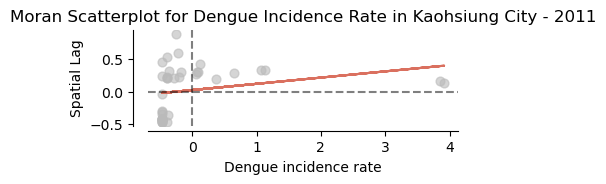

2012
neighbour value: dict_values([[87, 93, 99, 105, 117, 123, 129, 135, 141, 147, 153, 159, 177, 183, 189, 219, 225], [15, 21, 33, 57, 189, 195, 201, 213, 219], [9, 21, 57, 63, 165, 213], [9, 15, 33, 57, 213], [33, 39, 45, 51, 99, 105, 111, 171, 183, 189, 195, 201, 207, 213], [9, 21, 27, 39, 45, 51, 105, 111, 171, 183, 189, 195, 201, 207, 213], [27, 33, 45, 51, 87, 93, 99, 105, 111, 117, 123, 129, 135, 171, 177, 183, 189, 195, 201, 207, 213], [27, 33, 39, 51, 93, 99, 105, 111, 171, 183, 189, 195, 201, 207, 213], [27, 33, 39, 45, 111, 171, 195, 201, 207, 213], [9, 15, 21, 63, 69], [15, 57, 69, 165], [57, 63, 75], [69, 81], [75], [3, 39, 93, 99, 105, 111, 117, 123, 129, 135, 141, 147, 153, 159, 177, 183, 189, 207, 219, 225], [3, 39, 45, 87, 99, 105, 111, 117, 123, 129, 135, 141, 147, 153, 159, 177, 183, 189, 195, 201, 207, 219], [3, 27, 39, 45, 87, 93, 105, 111, 117, 123, 129, 135, 141, 147, 153, 159, 177, 183, 189, 195, 201, 207, 219], [3, 27, 33, 39, 45, 87, 93, 99, 111, 117, 123, 129

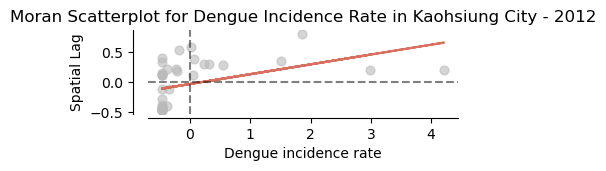

2013
neighbour value: dict_values([[89, 95, 101, 107, 119, 125, 131, 137, 143, 149, 155, 161, 179, 185, 191, 221, 227], [17, 23, 35, 59, 191, 197, 203, 215, 221], [11, 23, 59, 65, 167, 215], [11, 17, 35, 59, 215], [35, 41, 47, 53, 101, 107, 113, 173, 185, 191, 197, 203, 209, 215], [11, 23, 29, 41, 47, 53, 107, 113, 173, 185, 191, 197, 203, 209, 215], [29, 35, 47, 53, 89, 95, 101, 107, 113, 119, 125, 131, 137, 173, 179, 185, 191, 197, 203, 209, 215], [29, 35, 41, 53, 95, 101, 107, 113, 173, 185, 191, 197, 203, 209, 215], [29, 35, 41, 47, 113, 173, 197, 203, 209, 215], [11, 17, 23, 65, 71], [17, 59, 71, 167], [59, 65, 77], [71, 83], [77], [5, 41, 95, 101, 107, 113, 119, 125, 131, 137, 143, 149, 155, 161, 179, 185, 191, 209, 221, 227], [5, 41, 47, 89, 101, 107, 113, 119, 125, 131, 137, 143, 149, 155, 161, 179, 185, 191, 197, 203, 209, 221], [5, 29, 41, 47, 89, 95, 107, 113, 119, 125, 131, 137, 143, 149, 155, 161, 179, 185, 191, 197, 203, 209, 221], [5, 29, 35, 41, 47, 89, 95, 101, 113, 11

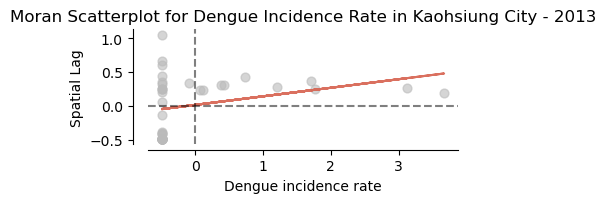

2014
neighbour value: dict_values([[85, 91, 97, 103, 115, 121, 127, 133, 139, 145, 151, 157, 175, 181, 187, 217, 223], [13, 19, 31, 55, 187, 193, 199, 211, 217], [7, 19, 55, 61, 163, 211], [7, 13, 31, 55, 211], [31, 37, 43, 49, 97, 103, 109, 169, 181, 187, 193, 199, 205, 211], [7, 19, 25, 37, 43, 49, 103, 109, 169, 181, 187, 193, 199, 205, 211], [25, 31, 43, 49, 85, 91, 97, 103, 109, 115, 121, 127, 133, 169, 175, 181, 187, 193, 199, 205, 211], [25, 31, 37, 49, 91, 97, 103, 109, 169, 181, 187, 193, 199, 205, 211], [25, 31, 37, 43, 109, 169, 193, 199, 205, 211], [7, 13, 19, 61, 67], [13, 55, 67, 163], [55, 61, 73], [67, 79], [73], [1, 37, 91, 97, 103, 109, 115, 121, 127, 133, 139, 145, 151, 157, 175, 181, 187, 205, 217, 223], [1, 37, 43, 85, 97, 103, 109, 115, 121, 127, 133, 139, 145, 151, 157, 175, 181, 187, 193, 199, 205, 217], [1, 25, 37, 43, 85, 91, 103, 109, 115, 121, 127, 133, 139, 145, 151, 157, 175, 181, 187, 193, 199, 205, 217], [1, 25, 31, 37, 43, 85, 91, 97, 109, 115, 121, 127

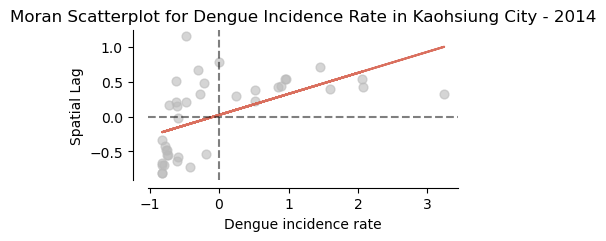

2015
neighbour value: dict_values([[86, 92, 98, 104, 116, 122, 128, 134, 140, 146, 152, 158, 176, 182, 188, 218, 224], [14, 20, 32, 56, 188, 194, 200, 212, 218], [8, 20, 56, 62, 164, 212], [8, 14, 32, 56, 212], [32, 38, 44, 50, 98, 104, 110, 170, 182, 188, 194, 200, 206, 212], [8, 20, 26, 38, 44, 50, 104, 110, 170, 182, 188, 194, 200, 206, 212], [26, 32, 44, 50, 86, 92, 98, 104, 110, 116, 122, 128, 134, 170, 176, 182, 188, 194, 200, 206, 212], [26, 32, 38, 50, 92, 98, 104, 110, 170, 182, 188, 194, 200, 206, 212], [26, 32, 38, 44, 110, 170, 194, 200, 206, 212], [8, 14, 20, 62, 68], [14, 56, 68, 164], [56, 62, 74], [68, 80], [74], [2, 38, 92, 98, 104, 110, 116, 122, 128, 134, 140, 146, 152, 158, 176, 182, 188, 206, 218, 224], [2, 38, 44, 86, 98, 104, 110, 116, 122, 128, 134, 140, 146, 152, 158, 176, 182, 188, 194, 200, 206, 218], [2, 26, 38, 44, 86, 92, 104, 110, 116, 122, 128, 134, 140, 146, 152, 158, 176, 182, 188, 194, 200, 206, 218], [2, 26, 32, 38, 44, 86, 92, 98, 110, 116, 122, 128

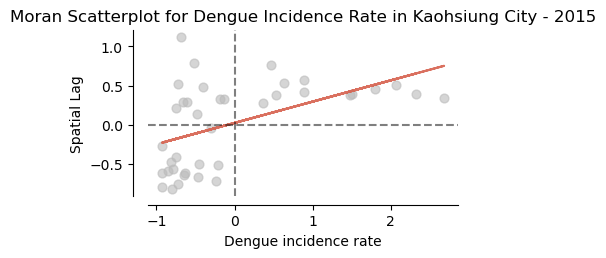

2016
neighbour value: dict_values([[88, 94, 100, 106, 118, 124, 130, 136, 142, 148, 154, 160, 178, 184, 190, 220, 226], [16, 22, 34, 58, 190, 196, 202, 214, 220], [10, 22, 58, 64, 166, 214], [10, 16, 34, 58, 214], [34, 40, 46, 52, 100, 106, 112, 172, 184, 190, 196, 202, 208, 214], [10, 22, 28, 40, 46, 52, 106, 112, 172, 184, 190, 196, 202, 208, 214], [28, 34, 46, 52, 88, 94, 100, 106, 112, 118, 124, 130, 136, 172, 178, 184, 190, 196, 202, 208, 214], [28, 34, 40, 52, 94, 100, 106, 112, 172, 184, 190, 196, 202, 208, 214], [28, 34, 40, 46, 112, 172, 196, 202, 208, 214], [10, 16, 22, 64, 70], [16, 58, 70, 166], [58, 64, 76], [70, 82], [76], [4, 40, 94, 100, 106, 112, 118, 124, 130, 136, 142, 148, 154, 160, 178, 184, 190, 208, 220, 226], [4, 40, 46, 88, 100, 106, 112, 118, 124, 130, 136, 142, 148, 154, 160, 178, 184, 190, 196, 202, 208, 220], [4, 28, 40, 46, 88, 94, 106, 112, 118, 124, 130, 136, 142, 148, 154, 160, 178, 184, 190, 196, 202, 208, 220], [4, 28, 34, 40, 46, 88, 94, 100, 112, 11

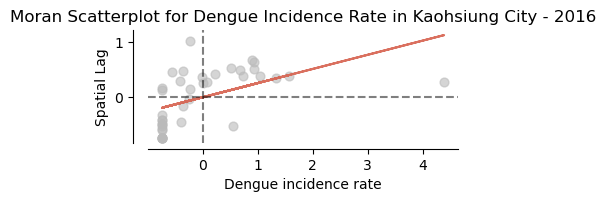

In [ ]:
for i in year_list:
    print(i)
    
    # filter the GeoDataFrame for the specific year
    gdf_year = ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i]
    
    # create a spatial weights matrix based on distance (20 km)
    w = DistanceBand.from_dataframe(gdf_year, threshold=20000, binary=True, silence_warnings=True)
    
    print("neighbour value:", w.neighbors.values())
    # calculate number of neighbors for each area
    n_neighbors = pd.Series([len(neighbors) for neighbors in w.neighbors.values()], 
                        index=w.neighbors.keys())

    # calculate statistics
    mean_neighbors = n_neighbors.mean()
    min_neighbors = n_neighbors.min()
    max_neighbors = n_neighbors.max()

    print(f"Mean number of neighbors: {mean_neighbors:.2f}")
    print(f"Min number of neighbors: {min_neighbors}")
    print(f"Max number of neighbors: {max_neighbors}")
    
    # calculate Moran's I
    mi = esda.Moran(gdf_year['dengue_rate'], w)
    
    print()
    print(f"Moran's I for {i}: {mi.I}")
    print(f"Moran's I p-value for {i}: {mi.p_sim}\n")
    
    # plot Moran's I
    fig, ax = plt.subplots(1, figsize=(4, 4))
    moran_scatterplot(mi, ax=ax)
    ax.set_title(f'Moran Scatterplot for Dengue Incidence Rate in Kaohsiung City - {i}')
    ax.set_xlabel('Dengue incidence rate')
    ax.set_ylabel('Spatial Lag')
    plt.show()

#### Local

2011
[0.001 0.012 0.004 0.061 0.046 0.012 0.049 0.041 0.005 0.03  0.07  0.065
 0.173 0.421 0.001 0.001 0.001 0.002 0.004 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.304 0.017 0.001 0.001 0.003 0.369 0.066 0.006 0.008
 0.001 0.001]
[2 3 3 3 3 3 2 3 3 3 3 3 3 3 1 2 1 1 2 1 1 1 1 1 2 2 1 3 3 1 2 2 3 2 2 3 2
 2]
number of hotspot: 10


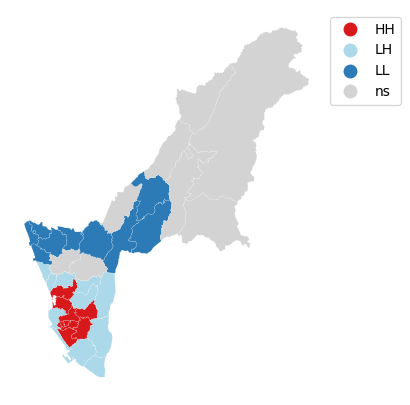

2012
[0.001 0.012 0.001 0.053 0.005 0.001 0.202 0.009 0.005 0.05  0.001 0.001
 0.001 0.001 0.001 0.077 0.091 0.154 0.208 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.001 0.007 0.001 0.154 0.211 0.021 0.178 0.234 0.001
 0.069 0.001]
[2 3 3 3 3 3 3 3 3 3 3 3 3 3 2 2 2 1 2 1 1 1 1 1 1 1 1 3 3 2 2 2 3 3 2 3 2
 1]
number of hotspot: 9


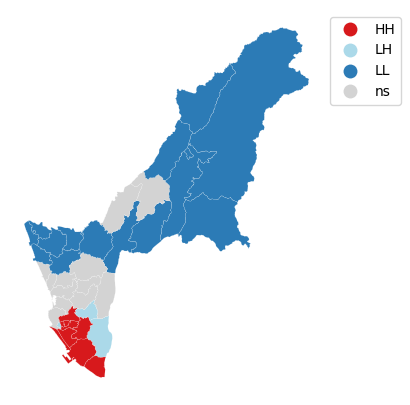

2013
[0.001 0.001 0.101 0.149 0.019 0.014 0.408 0.02  0.017 0.149 0.231 0.344
 0.471 0.313 0.001 0.001 0.003 0.001 0.001 0.001 0.001 0.001 0.004 0.001
 0.001 0.001 0.003 0.485 0.045 0.001 0.001 0.001 0.159 0.097 0.001 0.004
 0.001 0.001]
[2 3 3 3 3 3 2 3 3 3 3 3 3 3 2 2 2 1 2 1 1 1 1 1 1 2 1 3 3 1 1 2 3 2 2 3 2
 2]
number of hotspot: 10


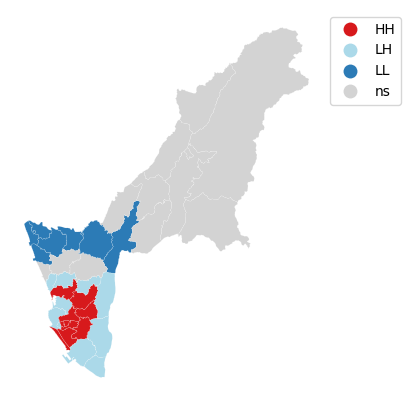

2014
[0.001 0.025 0.054 0.036 0.016 0.006 0.179 0.032 0.001 0.074 0.021 0.093
 0.007 0.126 0.001 0.001 0.001 0.002 0.035 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.238 0.002 0.001 0.001 0.013 0.385 0.188 0.04  0.003
 0.001 0.001]
[2 3 3 3 3 3 2 3 3 3 3 3 3 3 1 1 1 2 2 1 1 1 1 1 2 1 1 3 3 2 1 1 3 2 2 3 2
 2]
number of hotspot: 12


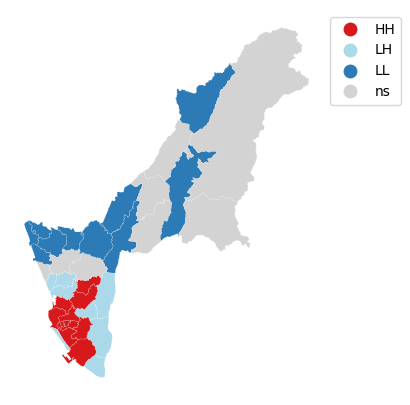

2015
[0.001 0.027 0.048 0.048 0.018 0.005 0.111 0.068 0.002 0.061 0.073 0.039
 0.038 0.123 0.001 0.001 0.001 0.001 0.004 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.151 0.014 0.001 0.001 0.004 0.341 0.191 0.005 0.001
 0.001 0.001]
[2 3 3 3 3 3 2 3 3 3 3 3 3 3 1 1 1 2 2 1 1 1 1 1 1 1 1 3 3 2 2 1 3 2 2 3 2
 2]
number of hotspot: 12


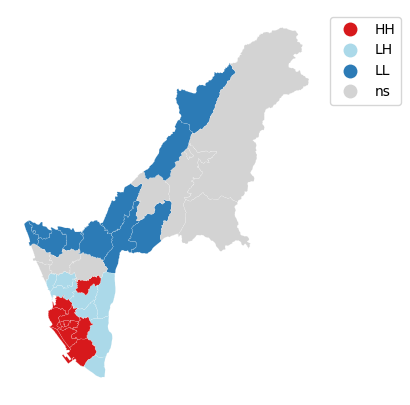

2016
[0.001 0.02  0.046 0.093 0.005 0.006 0.259 0.042 0.004 0.094 0.017 0.046
 0.137 0.383 0.001 0.001 0.002 0.003 0.088 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.134 0.009 0.001 0.004 0.004 0.151 0.406 0.07  0.008
 0.001 0.001]
[1 4 3 3 3 3 2 3 3 3 3 3 3 3 1 1 2 2 2 1 1 1 1 1 1 1 1 3 3 2 1 2 3 3 2 3 2
 2]
number of hotspot: 12


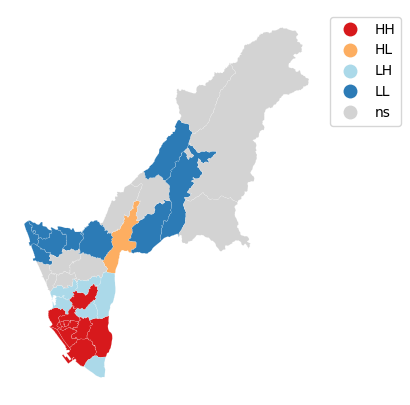

In [ ]:
# calculate Moran_Local and plot
for i in year_list:
    print(i)
    # filter the GeoDataFrame for the specific year
    gdf_year = ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i]
    
    # create a spatial weights matrix based on distance (20 km)
    w = DistanceBand.from_dataframe(gdf_year, threshold=20000, binary=True, silence_warnings=True)
    
    # calculate Moran's I    
    moran_loc = Moran_Local(ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i]['dengue_rate'], w)
    town_temp_list = ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i]['name_en'].to_list()
    print(moran_loc.p_sim)
    print(moran_loc.q)
    for j in range(len(moran_loc.q)):
        if moran_loc.p_sim[j] < 0.05:
            ks_analysis_gdf.loc[(ks_analysis_gdf['year_infected'] == i) & (ks_analysis_gdf['name_en'] == town_temp_list[j]), 'moran_q_distance'] = moran_loc.q[j]
        else:
            ks_analysis_gdf.loc[(ks_analysis_gdf['year_infected'] == i) & (ks_analysis_gdf['name_en'] == town_temp_list[j]), 'moran_q_distance'] = 0
    
    print("number of hotspot:", ks_analysis_gdf[(ks_analysis_gdf['year_infected']==i)&(ks_analysis_gdf['moran_q_distance']==1)].shape[0])
    
    lisa_cluster(moran_loc, 
                 ks_analysis_gdf[ks_analysis_gdf['year_infected'] == i], 
                 p=0.05, 
                 figsize=(5, 5),
                 legend_kwds={'loc': 'upper left', 'bbox_to_anchor': (1, 1)})
    plt.show()

In [87]:
# map the quardrant type
def cluster_type_distance(row):
    if row['moran_q_distance'] == 1:
        return 'HH'
    elif row['moran_q_distance'] == 2:
        return 'LH'
    elif row['moran_q_distance'] == 3:
        return 'LL'
    elif row['moran_q_distance'] == 4:
        return 'HL'
    else:
        return 'NS'

In [88]:
ks_analysis_gdf['moran_q_distance'] = ks_analysis_gdf.apply(cluster_type_distance, axis=1)

In [89]:
# # plot the dengue incidence rate in Kaohsiung City from 2011 to 2016
# test_gdf = ks_analysis_gdf.to_crs(epsg=4326).set_index('name_en')
# test_gdf = test_gdf.sort_values(by='year_infected')
# fig = px.choropleth_map(test_gdf,
#                         geojson=test_gdf.geometry,
#                         locations=test_gdf.index,
#                         color="moran_q_distance",
#                         labels={'moran_q_distance': 'quadrant location'},
#                         map_style="open-street-map",
#                         zoom=8, 
#                         animation_frame='year_infected',
#                         center={"lat": 22.6273, "lon": 120.3014},
#                         title='Dengue incidence cluster in Kaohsiung City from 2011 to 2016 (distance based)')
# fig.show()

## Moran's I (monthly)

In [90]:
ks_analysis_monthly_gdf.head()

,name_en,month_infected,admin_level,osm_admin_level,name,population,hasc,geometry,Township_infected,count,dengue_rate
0,Daliao District,1,10,7,大寮區,148765.0,None,"MULTIPOLYGON (((185061.651 2499414.373, 185062...",Daliao District,26.0,0.017477
1,Daliao District,2,10,7,大寮區,148765.0,None,"MULTIPOLYGON (((185061.651 2499414.373, 185062...",NaN,0.0,0.000000
2,Daliao District,3,10,7,大寮區,148765.0,None,"MULTIPOLYGON (((185061.651 2499414.373, 185062...",NaN,0.0,0.000000
3,Daliao District,4,10,7,大寮區,148765.0,None,"MULTIPOLYGON (((185061.651 2499414.373, 185062...",NaN,0.0,0.000000
4,Daliao District,5,10,7,大寮區,148765.0,None,"MULTIPOLYGON (((185061.651 2499414.373, 185062...",NaN,0.0,0.000000


### Contiguity based (Queen)

#### Global moran's I

In [91]:
month_list = sorted(ks_analysis_monthly_gdf['month_infected'].unique())

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 1
Moran's I for 1: 0.6159327681476747
Moran's I p-value for 1: 0.001

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


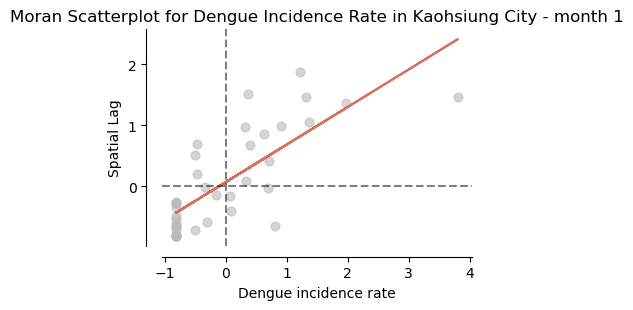

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 2
Moran's I for 2: 0.30742088754734315
Moran's I p-value for 2: 0.002

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


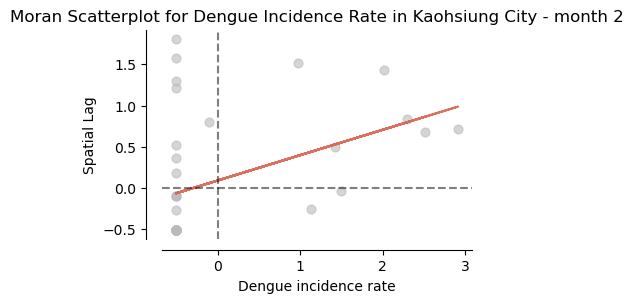

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 3
Moran's I for 3: 0.10728693506745741
Moran's I p-value for 3: 0.08

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


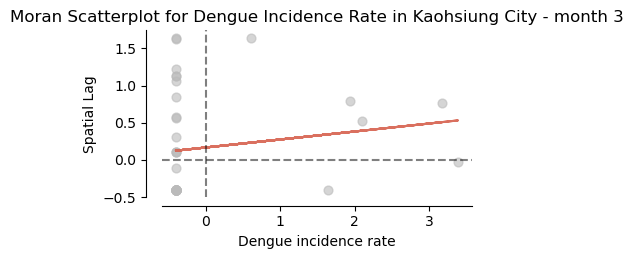


Month: 4
Moran's I for 4: 0.1007686373474878
Moran's I p-value for 4: 0.089

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



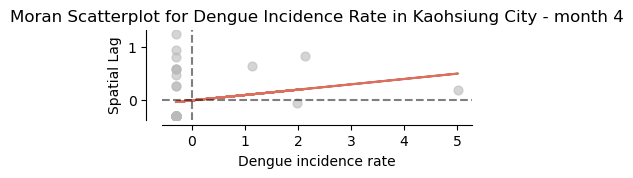

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 5
Moran's I for 5: 0.11755436921773667
Moran's I p-value for 5: 0.066

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


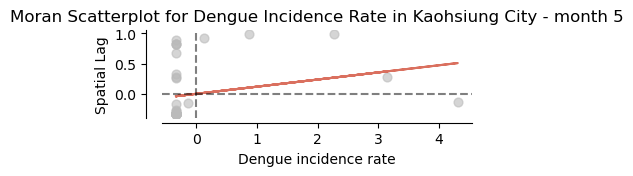

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 6
Moran's I for 6: 0.2753722376122704
Moran's I p-value for 6: 0.011

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


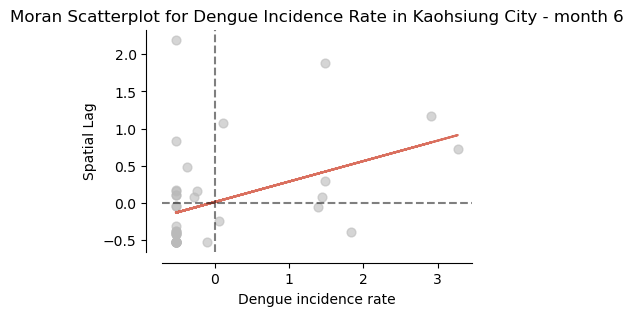

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 7
Moran's I for 7: 0.3126922973666458
Moran's I p-value for 7: 0.006

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


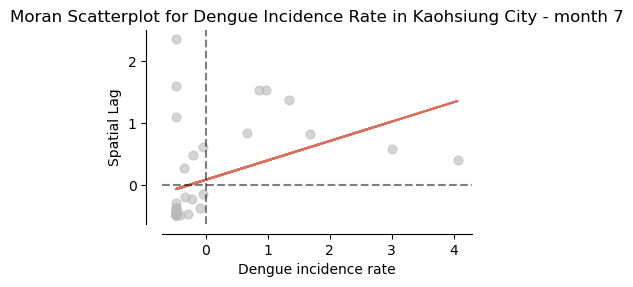

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 8
Moran's I for 8: 0.34915578278054704
Moran's I p-value for 8: 0.001

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


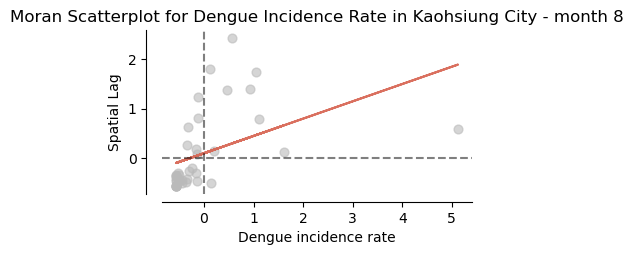

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 9
Moran's I for 9: 0.7391861999386355
Moran's I p-value for 9: 0.001

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


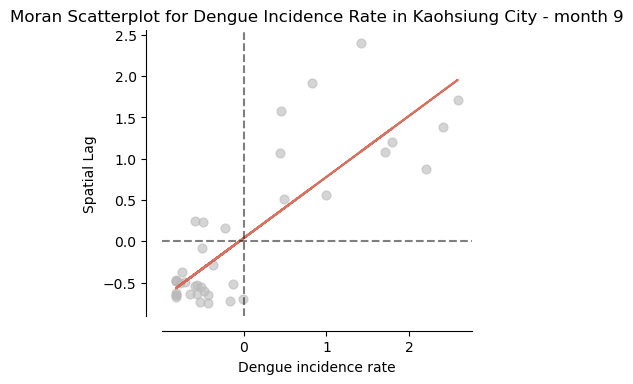


Month: 10
Moran's I for 10: 0.7468862818617513
Moran's I p-value for 10: 0.001

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



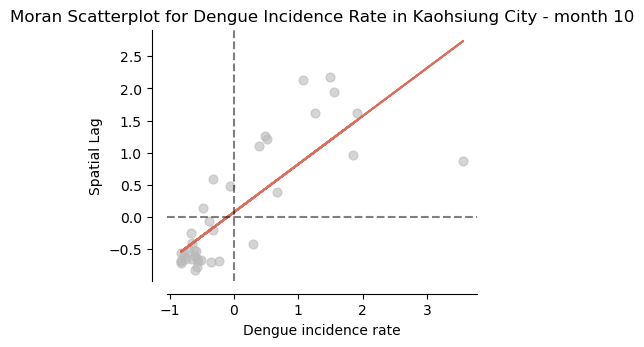

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 11
Moran's I for 11: 0.7208305896062288
Moran's I p-value for 11: 0.001

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


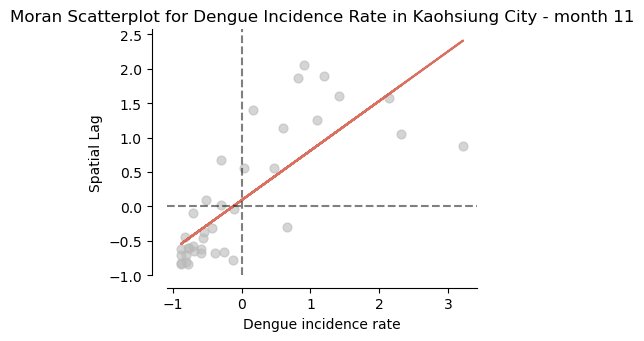

/tmp/ipykernel_965/235657059.py:2: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning




Month: 12
Moran's I for 12: 0.6897814719416507
Moran's I p-value for 12: 0.001

neighbour value: dict_values([[36, 37, 25, 26, 29], [33, 2, 3, 35, 36, 9], [1, 10, 9], [1, 35, 9], [32, 5, 7, 8, 28], [32, 35, 4], [32, 34, 7], [32, 4, 28, 6], [4, 28], [1, 2, 3, 10, 11], [2, 11, 9, 27, 13], [9, 10, 12, 13], [11, 13], [11, 10, 27, 12], [19, 20, 21, 15], [16, 19, 21, 23, 24, 14], [17, 19, 30, 15], [16, 33, 34, 18, 30, 31], [32, 17, 34, 33], [14, 15, 16, 20, 21, 22, 26, 29, 30], [19, 21, 22, 14], [19, 20, 22, 23, 26, 14, 15], [19, 20, 21], [21, 24, 25, 26, 15], [25, 15, 23], [0, 37, 23, 24, 26], [0, 19, 21, 23, 25, 29], [10, 13], [8, 4, 7], [0, 19, 36, 26, 30], [16, 17, 19, 36, 29, 31], [17, 36, 30, 33], [33, 34, 35, 4, 5, 6, 7, 18], [32, 1, 17, 35, 36, 18, 31], [32, 17, 18, 6], [32, 1, 33, 3, 5], [0, 1, 33, 29, 30, 31], [0, 25]])
Mean number of neighbors: 4.53
Min number of neighbors: 2
Max number of neighbors: 9


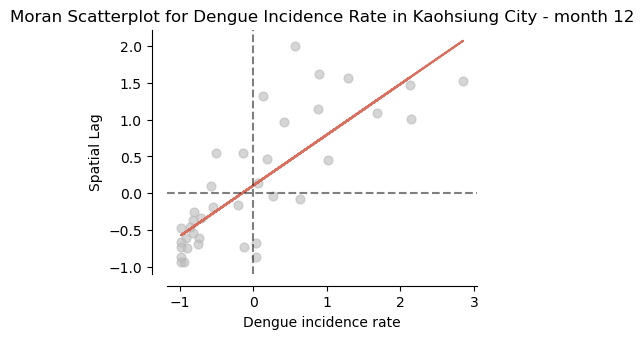

In [ ]:
for i in month_list:
    w = Queen.from_dataframe(ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i])
    w.transform = 'r'
    
    mi = esda.Moran(ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i]['dengue_rate'], w)

    print()
    print('Month:', i)
    print(f"Moran's I for {i}: {mi.I}")
    print(f"Moran's I p-value for {i}: {mi.p_sim}\n")

    print("neighbour value:", w.neighbors.values())
    # calculate number of neighbors for each area
    n_neighbors = pd.Series([len(neighbors) for neighbors in w.neighbors.values()], 
                        index=w.neighbors.keys())

    # calculate statistics
    mean_neighbors = n_neighbors.mean()
    min_neighbors = n_neighbors.min()
    max_neighbors = n_neighbors.max()

    print(f"Mean number of neighbors: {mean_neighbors:.2f}")
    print(f"Min number of neighbors: {min_neighbors}")
    print(f"Max number of neighbors: {max_neighbors}")
    
    fig, ax = plt.subplots(1, figsize=(4, 4))
    moran_scatterplot(mi, ax=ax)
    ax.set_title(f'Moran Scatterplot for Dengue Incidence Rate in Kaohsiung City - month {i}')
    ax.set_xlabel('Dengue incidence rate')
    ax.set_ylabel('Spatial Lag')
    plt.show()

#### Local moran's I

1
[0.475 0.025 0.329 0.329 0.023 0.155 0.111 0.07  0.151 0.082 0.007 0.017
 0.135 0.017 0.001 0.001 0.104 0.499 0.214 0.001 0.001 0.001 0.017 0.02
 0.064 0.152 0.024 0.141 0.056 0.131 0.373 0.401 0.015 0.359 0.227 0.243
 0.288 0.139]
number of hotspot: 8


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



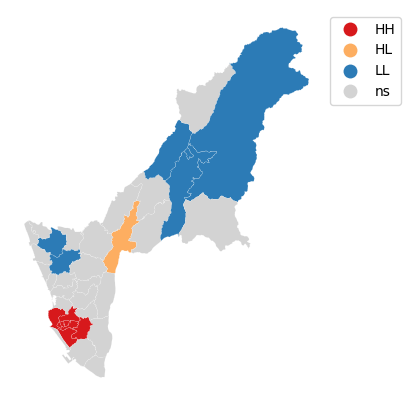

2
[0.226 0.164 0.44  0.44  0.237 0.44  0.44  0.323 0.41  0.237 0.237 0.323
 0.41  0.323 0.003 0.027 0.005 0.246 0.467 0.007 0.006 0.011 0.012 0.007
 0.031 0.489 0.037 0.418 0.433 0.292 0.111 0.467 0.084 0.216 0.467 0.229
 0.165 0.21 ]
number of hotspot: 5


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



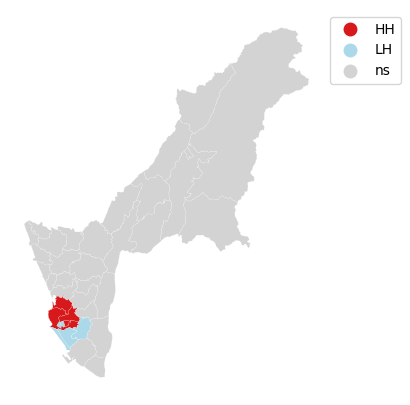

3


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



[0.301 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.018 0.005 0.038 0.001 0.41  0.414 0.024 0.009 0.006 0.028
 0.011 0.089 0.001 0.001 0.001 0.112 0.116 0.406 0.198 0.398 0.406 0.001
 0.001 0.111]
number of hotspot: 3


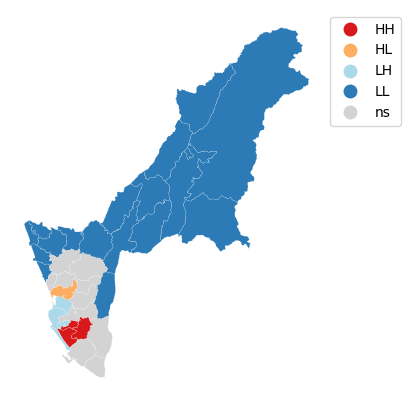

4
[0.013 0.495 0.292 0.292 0.444 0.292 0.292 0.381 0.203 0.444 0.444 0.381
 0.203 0.381 0.294 0.417 0.297 0.476 0.387 0.005 0.387 0.089 0.294 0.148
 0.092 0.149 0.045 0.23  0.316 0.072 0.161 0.384 0.366 0.42  0.384 0.461
 0.06  0.226]
number of hotspot: 1


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



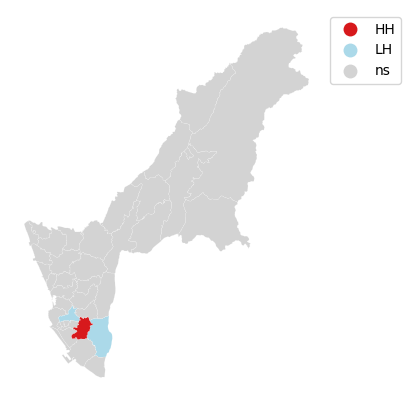

5
[0.001 0.001 0.434 0.434 0.001 0.434 0.434 0.474 0.307 0.001 0.001 0.474
 0.307 0.474 0.38  0.024 0.023 0.414 0.057 0.394 0.462 0.251 0.386 0.187
 0.103 0.047 0.261 0.297 0.436 0.378 0.066 0.062 0.194 0.199 0.062 0.001
 0.001 0.297]
number of hotspot: 2


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



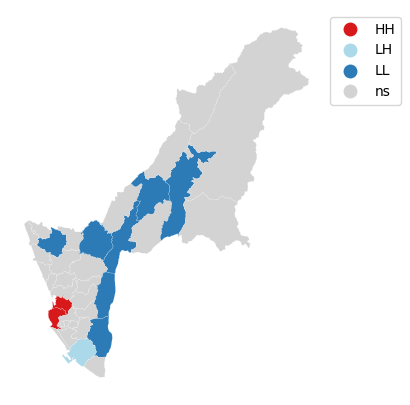

6
[0.213 0.157 0.001 0.001 0.001 0.399 0.001 0.252 0.437 0.001 0.001 0.001
 0.001 0.001 0.252 0.03  0.342 0.448 0.37  0.403 0.313 0.098 0.405 0.025
 0.008 0.003 0.011 0.001 0.401 0.388 0.344 0.326 0.119 0.204 0.442 0.24
 0.5   0.017]
number of hotspot: 4


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



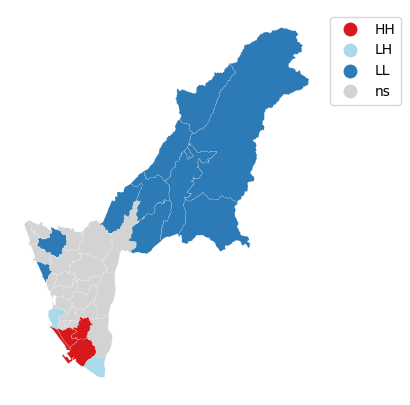

7
[0.041 0.057 0.284 0.284 0.061 0.2   0.2   0.123 0.338 0.094 0.046 0.104
 0.338 0.104 0.031 0.13  0.467 0.215 0.32  0.024 0.059 0.027 0.013 0.003
 0.015 0.078 0.002 0.331 0.183 0.235 0.341 0.392 0.009 0.143 0.322 0.132
 0.374 0.013]
number of hotspot: 5


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



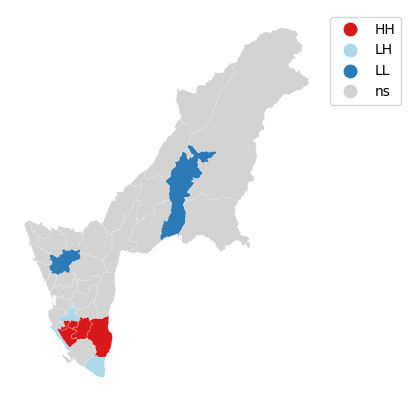

8
[0.192 0.011 0.307 0.294 0.07  0.098 0.055 0.049 0.205 0.069 0.002 0.002
 0.06  0.002 0.002 0.003 0.244 0.247 0.088 0.002 0.004 0.001 0.001 0.006
 0.09  0.221 0.002 0.056 0.246 0.247 0.322 0.29  0.005 0.161 0.09  0.133
 0.344 0.096]
number of hotspot: 7


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



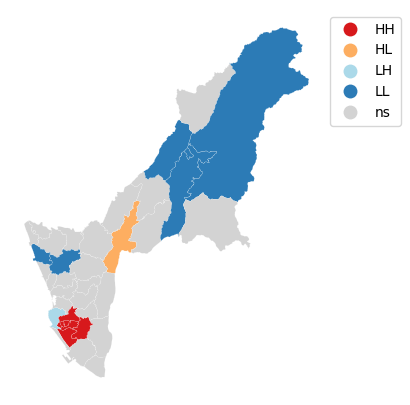

9


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



[0.436 0.001 0.215 0.123 0.099 0.088 0.093 0.045 0.111 0.135 0.006 0.01
 0.196 0.051 0.001 0.001 0.14  0.238 0.137 0.001 0.001 0.001 0.001 0.007
 0.039 0.096 0.008 0.113 0.241 0.293 0.335 0.158 0.003 0.055 0.124 0.119
 0.156 0.336]
number of hotspot: 9


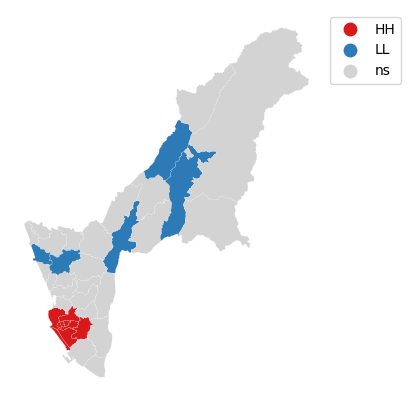

10
[0.472 0.007 0.163 0.115 0.018 0.087 0.085 0.02  0.018 0.035 0.014 0.018
 0.012 0.112 0.001 0.001 0.029 0.307 0.139 0.001 0.001 0.001 0.001 0.013
 0.029 0.162 0.002 0.116 0.024 0.089 0.1   0.226 0.002 0.114 0.146 0.085
 0.271 0.389]
number of hotspot: 10


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



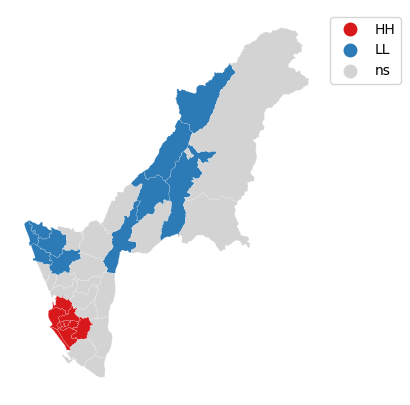

11
[0.455 0.013 0.151 0.129 0.009 0.075 0.133 0.016 0.017 0.034 0.029 0.005
 0.016 0.053 0.002 0.001 0.019 0.492 0.218 0.001 0.001 0.001 0.003 0.011
 0.026 0.124 0.002 0.079 0.004 0.089 0.101 0.301 0.002 0.171 0.17  0.116
 0.411 0.398]
number of hotspot: 10


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



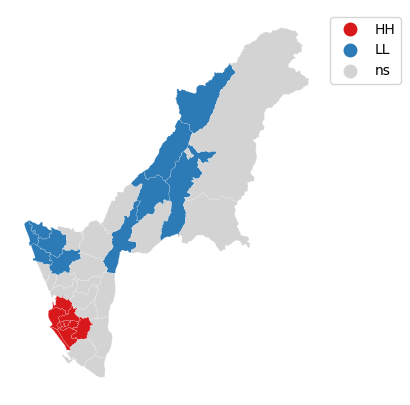

12
[0.34  0.027 0.377 0.178 0.026 0.136 0.137 0.042 0.029 0.151 0.006 0.063
 0.075 0.066 0.001 0.001 0.024 0.493 0.375 0.003 0.001 0.001 0.006 0.008
 0.019 0.113 0.002 0.286 0.004 0.101 0.098 0.493 0.003 0.357 0.292 0.208
 0.369 0.21 ]
number of hotspot: 10


/tmp/ipykernel_965/2541734462.py:5: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



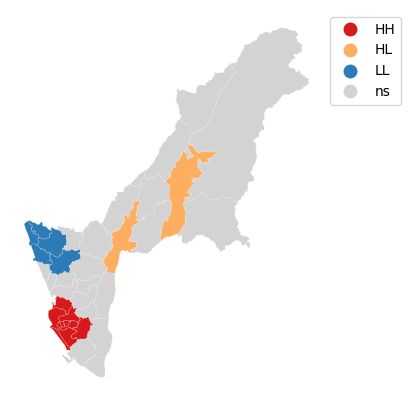

In [ ]:
# calculate Moran_Local and plot
for i in month_list:
    print(i)
    # create a spatial weights matrix
    w = Queen.from_dataframe(ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i])
    w.transform = 'r'
    
    # calculate Moran's I    
    moran_loc = Moran_Local(ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i]['dengue_rate'], w)
    town_temp_list = ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i]['name_en'].to_list()
    print(moran_loc.p_sim)
    for j in range(len(moran_loc.q)):
        if moran_loc.p_sim[j] < 0.05:
            ks_analysis_monthly_gdf.loc[(ks_analysis_monthly_gdf['month_infected'] == i) & (ks_analysis_monthly_gdf['name_en'] == town_temp_list[j]), 'moran_q_queen'] = moran_loc.q[j]
        else:
            ks_analysis_monthly_gdf.loc[(ks_analysis_monthly_gdf['month_infected'] == i) & (ks_analysis_monthly_gdf['name_en'] == town_temp_list[j]), 'moran_q_queen'] = 0
    
    print("number of hotspot:", ks_analysis_monthly_gdf[(ks_analysis_monthly_gdf['month_infected']==i)&(ks_analysis_monthly_gdf['moran_q_queen']==1)].shape[0])

    lisa_cluster(moran_loc, 
                 ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i], 
                 p=0.05, 
                 figsize=(5, 5),
                 legend_kwds={'loc': 'upper left', 'bbox_to_anchor': (1, 1)})
    plt.show()

In [94]:
# ks_analysis_monthly_gdf['moran_q_queen'] = ks_analysis_monthly_gdf.apply(cluster_type_queen, axis=1)

In [95]:
# # plot the dengue incidence rate in Kaohsiung City from 2011 to 2016
# test_gdf = ks_analysis_monthly_gdf.to_crs(epsg=4326).set_index('Township_infected')
# test_gdf = test_gdf[test_gdf['month_infected'] == 12]
# fig = px.choropleth_map(test_gdf,
#                         geojson=test_gdf.geometry,
#                         locations=test_gdf.index,
#                         color="moran_q_queen",
#                         labels={'moran_q_queen': 'quadrant location'},
#                         map_style="open-street-map",
#                         zoom=8, 
#                         center={"lat": 22.6273, "lon": 120.3014},
#                         title='Dengue incidence cluster in Kaohsiung City from month 1 to 12 (queen contiguity)')
# fig.show()

### Distance based (20 km)

#### Global

1
Moran's I for 1: 0.28583598903240987
Moran's I p-value for 1: 0.006

neighbour value: dict_values([[168, 180, 192, 204, 228, 240, 252, 264, 276, 288, 300, 312, 348, 360, 372, 432, 444], [24, 36, 60, 108, 372, 384, 396, 420, 432], [12, 36, 108, 120, 324, 420], [12, 24, 60, 108, 420], [60, 72, 84, 96, 192, 204, 216, 336, 360, 372, 384, 396, 408, 420], [12, 36, 48, 72, 84, 96, 204, 216, 336, 360, 372, 384, 396, 408, 420], [48, 60, 84, 96, 168, 180, 192, 204, 216, 228, 240, 252, 264, 336, 348, 360, 372, 384, 396, 408, 420], [48, 60, 72, 96, 180, 192, 204, 216, 336, 360, 372, 384, 396, 408, 420], [48, 60, 72, 84, 216, 336, 384, 396, 408, 420], [12, 24, 36, 120, 132], [24, 108, 132, 324], [108, 120, 144], [132, 156], [144], [0, 72, 180, 192, 204, 216, 228, 240, 252, 264, 276, 288, 300, 312, 348, 360, 372, 408, 432, 444], [0, 72, 84, 168, 192, 204, 216, 228, 240, 252, 264, 276, 288, 300, 312, 348, 360, 372, 384, 396, 408, 432], [0, 48, 72, 84, 168, 180, 204, 216, 228, 240, 252, 264, 276, 28

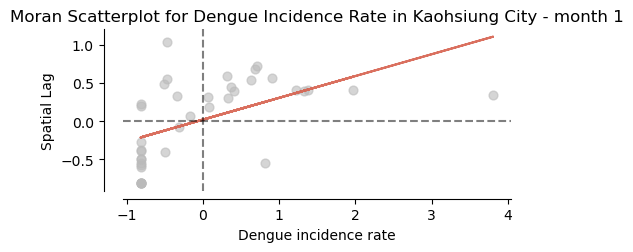

2
Moran's I for 2: 0.13696215728150837
Moran's I p-value for 2: 0.023

neighbour value: dict_values([[169, 181, 193, 205, 229, 241, 253, 265, 277, 289, 301, 313, 349, 361, 373, 433, 445], [25, 37, 61, 109, 373, 385, 397, 421, 433], [13, 37, 109, 121, 325, 421], [13, 25, 61, 109, 421], [61, 73, 85, 97, 193, 205, 217, 337, 361, 373, 385, 397, 409, 421], [13, 37, 49, 73, 85, 97, 205, 217, 337, 361, 373, 385, 397, 409, 421], [49, 61, 85, 97, 169, 181, 193, 205, 217, 229, 241, 253, 265, 337, 349, 361, 373, 385, 397, 409, 421], [49, 61, 73, 97, 181, 193, 205, 217, 337, 361, 373, 385, 397, 409, 421], [49, 61, 73, 85, 217, 337, 385, 397, 409, 421], [13, 25, 37, 121, 133], [25, 109, 133, 325], [109, 121, 145], [133, 157], [145], [1, 73, 181, 193, 205, 217, 229, 241, 253, 265, 277, 289, 301, 313, 349, 361, 373, 409, 433, 445], [1, 73, 85, 169, 193, 205, 217, 229, 241, 253, 265, 277, 289, 301, 313, 349, 361, 373, 385, 397, 409, 433], [1, 49, 73, 85, 169, 181, 205, 217, 229, 241, 253, 265, 277, 28

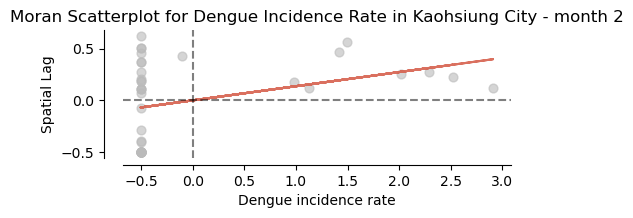

3
Moran's I for 3: 0.08543120948512499
Moran's I p-value for 3: 0.04

neighbour value: dict_values([[170, 182, 194, 206, 230, 242, 254, 266, 278, 290, 302, 314, 350, 362, 374, 434, 446], [26, 38, 62, 110, 374, 386, 398, 422, 434], [14, 38, 110, 122, 326, 422], [14, 26, 62, 110, 422], [62, 74, 86, 98, 194, 206, 218, 338, 362, 374, 386, 398, 410, 422], [14, 38, 50, 74, 86, 98, 206, 218, 338, 362, 374, 386, 398, 410, 422], [50, 62, 86, 98, 170, 182, 194, 206, 218, 230, 242, 254, 266, 338, 350, 362, 374, 386, 398, 410, 422], [50, 62, 74, 98, 182, 194, 206, 218, 338, 362, 374, 386, 398, 410, 422], [50, 62, 74, 86, 218, 338, 386, 398, 410, 422], [14, 26, 38, 122, 134], [26, 110, 134, 326], [110, 122, 146], [134, 158], [146], [2, 74, 182, 194, 206, 218, 230, 242, 254, 266, 278, 290, 302, 314, 350, 362, 374, 410, 434, 446], [2, 74, 86, 170, 194, 206, 218, 230, 242, 254, 266, 278, 290, 302, 314, 350, 362, 374, 386, 398, 410, 434], [2, 50, 74, 86, 170, 182, 206, 218, 230, 242, 254, 266, 278, 290

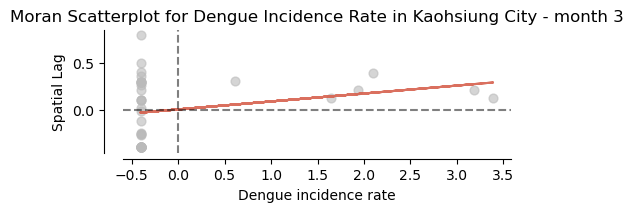

4
Moran's I for 4: 0.019128963037300654
Moran's I p-value for 4: 0.107

neighbour value: dict_values([[171, 183, 195, 207, 231, 243, 255, 267, 279, 291, 303, 315, 351, 363, 375, 435, 447], [27, 39, 63, 111, 375, 387, 399, 423, 435], [15, 39, 111, 123, 327, 423], [15, 27, 63, 111, 423], [63, 75, 87, 99, 195, 207, 219, 339, 363, 375, 387, 399, 411, 423], [15, 39, 51, 75, 87, 99, 207, 219, 339, 363, 375, 387, 399, 411, 423], [51, 63, 87, 99, 171, 183, 195, 207, 219, 231, 243, 255, 267, 339, 351, 363, 375, 387, 399, 411, 423], [51, 63, 75, 99, 183, 195, 207, 219, 339, 363, 375, 387, 399, 411, 423], [51, 63, 75, 87, 219, 339, 387, 399, 411, 423], [15, 27, 39, 123, 135], [27, 111, 135, 327], [111, 123, 147], [135, 159], [147], [3, 75, 183, 195, 207, 219, 231, 243, 255, 267, 279, 291, 303, 315, 351, 363, 375, 411, 435, 447], [3, 75, 87, 171, 195, 207, 219, 231, 243, 255, 267, 279, 291, 303, 315, 351, 363, 375, 387, 399, 411, 435], [3, 51, 75, 87, 171, 183, 207, 219, 231, 243, 255, 267, 279, 2

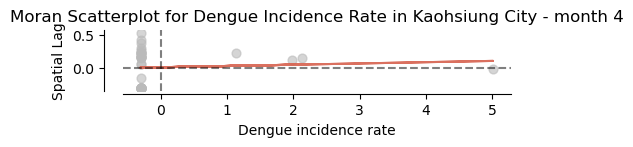

5
Moran's I for 5: 0.026096603342405846
Moran's I p-value for 5: 0.102

neighbour value: dict_values([[172, 184, 196, 208, 232, 244, 256, 268, 280, 292, 304, 316, 352, 364, 376, 436, 448], [28, 40, 64, 112, 376, 388, 400, 424, 436], [16, 40, 112, 124, 328, 424], [16, 28, 64, 112, 424], [64, 76, 88, 100, 196, 208, 220, 340, 364, 376, 388, 400, 412, 424], [16, 40, 52, 76, 88, 100, 208, 220, 340, 364, 376, 388, 400, 412, 424], [52, 64, 88, 100, 172, 184, 196, 208, 220, 232, 244, 256, 268, 340, 352, 364, 376, 388, 400, 412, 424], [52, 64, 76, 100, 184, 196, 208, 220, 340, 364, 376, 388, 400, 412, 424], [52, 64, 76, 88, 220, 340, 388, 400, 412, 424], [16, 28, 40, 124, 136], [28, 112, 136, 328], [112, 124, 148], [136, 160], [148], [4, 76, 184, 196, 208, 220, 232, 244, 256, 268, 280, 292, 304, 316, 352, 364, 376, 412, 436, 448], [4, 76, 88, 172, 196, 208, 220, 232, 244, 256, 268, 280, 292, 304, 316, 352, 364, 376, 388, 400, 412, 436], [4, 52, 76, 88, 172, 184, 208, 220, 232, 244, 256, 268, 28

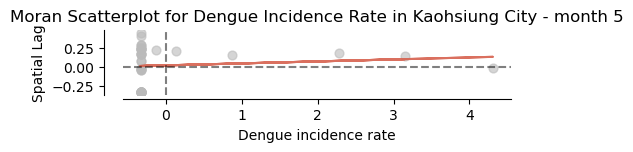

6
Moran's I for 6: 0.16155206442155443
Moran's I p-value for 6: 0.02

neighbour value: dict_values([[173, 185, 197, 209, 233, 245, 257, 269, 281, 293, 305, 317, 353, 365, 377, 437, 449], [29, 41, 65, 113, 377, 389, 401, 425, 437], [17, 41, 113, 125, 329, 425], [17, 29, 65, 113, 425], [65, 77, 89, 101, 197, 209, 221, 341, 365, 377, 389, 401, 413, 425], [17, 41, 53, 77, 89, 101, 209, 221, 341, 365, 377, 389, 401, 413, 425], [53, 65, 89, 101, 173, 185, 197, 209, 221, 233, 245, 257, 269, 341, 353, 365, 377, 389, 401, 413, 425], [53, 65, 77, 101, 185, 197, 209, 221, 341, 365, 377, 389, 401, 413, 425], [53, 65, 77, 89, 221, 341, 389, 401, 413, 425], [17, 29, 41, 125, 137], [29, 113, 137, 329], [113, 125, 149], [137, 161], [149], [5, 77, 185, 197, 209, 221, 233, 245, 257, 269, 281, 293, 305, 317, 353, 365, 377, 413, 437, 449], [5, 77, 89, 173, 197, 209, 221, 233, 245, 257, 269, 281, 293, 305, 317, 353, 365, 377, 389, 401, 413, 437], [5, 53, 77, 89, 173, 185, 209, 221, 233, 245, 257, 269, 281,

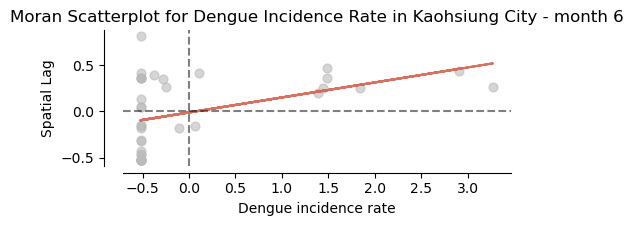

7
Moran's I for 7: 0.15313134364174658
Moran's I p-value for 7: 0.022

neighbour value: dict_values([[174, 186, 198, 210, 234, 246, 258, 270, 282, 294, 306, 318, 354, 366, 378, 438, 450], [30, 42, 66, 114, 378, 390, 402, 426, 438], [18, 42, 114, 126, 330, 426], [18, 30, 66, 114, 426], [66, 78, 90, 102, 198, 210, 222, 342, 366, 378, 390, 402, 414, 426], [18, 42, 54, 78, 90, 102, 210, 222, 342, 366, 378, 390, 402, 414, 426], [54, 66, 90, 102, 174, 186, 198, 210, 222, 234, 246, 258, 270, 342, 354, 366, 378, 390, 402, 414, 426], [54, 66, 78, 102, 186, 198, 210, 222, 342, 366, 378, 390, 402, 414, 426], [54, 66, 78, 90, 222, 342, 390, 402, 414, 426], [18, 30, 42, 126, 138], [30, 114, 138, 330], [114, 126, 150], [138, 162], [150], [6, 78, 186, 198, 210, 222, 234, 246, 258, 270, 282, 294, 306, 318, 354, 366, 378, 414, 438, 450], [6, 78, 90, 174, 198, 210, 222, 234, 246, 258, 270, 282, 294, 306, 318, 354, 366, 378, 390, 402, 414, 438], [6, 54, 78, 90, 174, 186, 210, 222, 234, 246, 258, 270, 282

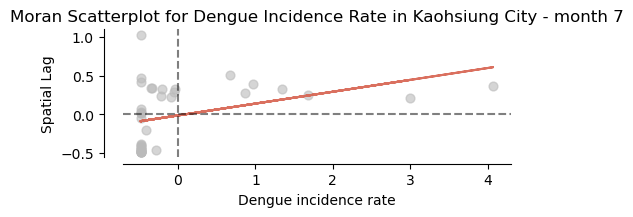

8
Moran's I for 8: 0.12490788931899457
Moran's I p-value for 8: 0.018

neighbour value: dict_values([[175, 187, 199, 211, 235, 247, 259, 271, 283, 295, 307, 319, 355, 367, 379, 439, 451], [31, 43, 67, 115, 379, 391, 403, 427, 439], [19, 43, 115, 127, 331, 427], [19, 31, 67, 115, 427], [67, 79, 91, 103, 199, 211, 223, 343, 367, 379, 391, 403, 415, 427], [19, 43, 55, 79, 91, 103, 211, 223, 343, 367, 379, 391, 403, 415, 427], [55, 67, 91, 103, 175, 187, 199, 211, 223, 235, 247, 259, 271, 343, 355, 367, 379, 391, 403, 415, 427], [55, 67, 79, 103, 187, 199, 211, 223, 343, 367, 379, 391, 403, 415, 427], [55, 67, 79, 91, 223, 343, 391, 403, 415, 427], [19, 31, 43, 127, 139], [31, 115, 139, 331], [115, 127, 151], [139, 163], [151], [7, 79, 187, 199, 211, 223, 235, 247, 259, 271, 283, 295, 307, 319, 355, 367, 379, 415, 439, 451], [7, 79, 91, 175, 199, 211, 223, 235, 247, 259, 271, 283, 295, 307, 319, 355, 367, 379, 391, 403, 415, 439], [7, 55, 79, 91, 175, 187, 211, 223, 235, 247, 259, 271, 283

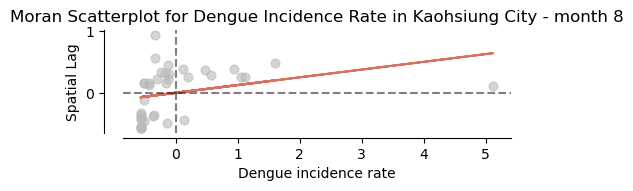

9
Moran's I for 9: 0.24136240835507397
Moran's I p-value for 9: 0.006

neighbour value: dict_values([[176, 188, 200, 212, 236, 248, 260, 272, 284, 296, 308, 320, 356, 368, 380, 440, 452], [32, 44, 68, 116, 380, 392, 404, 428, 440], [20, 44, 116, 128, 332, 428], [20, 32, 68, 116, 428], [68, 80, 92, 104, 200, 212, 224, 344, 368, 380, 392, 404, 416, 428], [20, 44, 56, 80, 92, 104, 212, 224, 344, 368, 380, 392, 404, 416, 428], [56, 68, 92, 104, 176, 188, 200, 212, 224, 236, 248, 260, 272, 344, 356, 368, 380, 392, 404, 416, 428], [56, 68, 80, 104, 188, 200, 212, 224, 344, 368, 380, 392, 404, 416, 428], [56, 68, 80, 92, 224, 344, 392, 404, 416, 428], [20, 32, 44, 128, 140], [32, 116, 140, 332], [116, 128, 152], [140, 164], [152], [8, 80, 188, 200, 212, 224, 236, 248, 260, 272, 284, 296, 308, 320, 356, 368, 380, 416, 440, 452], [8, 80, 92, 176, 200, 212, 224, 236, 248, 260, 272, 284, 296, 308, 320, 356, 368, 380, 392, 404, 416, 440], [8, 56, 80, 92, 176, 188, 212, 224, 236, 248, 260, 272, 284

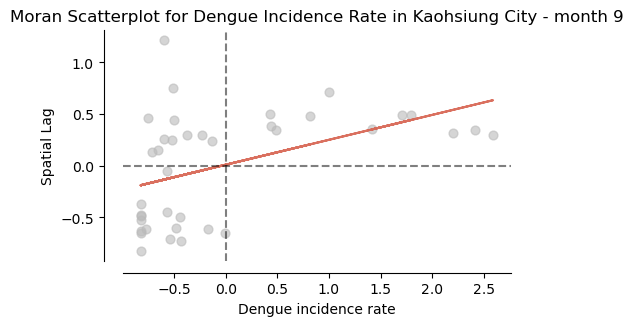

10
Moran's I for 10: 0.25908834046671336
Moran's I p-value for 10: 0.006

neighbour value: dict_values([[177, 189, 201, 213, 237, 249, 261, 273, 285, 297, 309, 321, 357, 369, 381, 441, 453], [33, 45, 69, 117, 381, 393, 405, 429, 441], [21, 45, 117, 129, 333, 429], [21, 33, 69, 117, 429], [69, 81, 93, 105, 201, 213, 225, 345, 369, 381, 393, 405, 417, 429], [21, 45, 57, 81, 93, 105, 213, 225, 345, 369, 381, 393, 405, 417, 429], [57, 69, 93, 105, 177, 189, 201, 213, 225, 237, 249, 261, 273, 345, 357, 369, 381, 393, 405, 417, 429], [57, 69, 81, 105, 189, 201, 213, 225, 345, 369, 381, 393, 405, 417, 429], [57, 69, 81, 93, 225, 345, 393, 405, 417, 429], [21, 33, 45, 129, 141], [33, 117, 141, 333], [117, 129, 153], [141, 165], [153], [9, 81, 189, 201, 213, 225, 237, 249, 261, 273, 285, 297, 309, 321, 357, 369, 381, 417, 441, 453], [9, 81, 93, 177, 201, 213, 225, 237, 249, 261, 273, 285, 297, 309, 321, 357, 369, 381, 393, 405, 417, 441], [9, 57, 81, 93, 177, 189, 213, 225, 237, 249, 261, 273, 

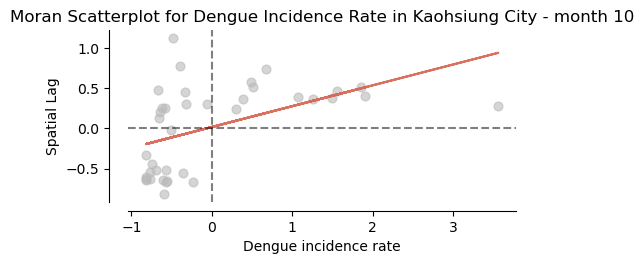

11
Moran's I for 11: 0.28928248688345204
Moran's I p-value for 11: 0.002

neighbour value: dict_values([[178, 190, 202, 214, 238, 250, 262, 274, 286, 298, 310, 322, 358, 370, 382, 442, 454], [34, 46, 70, 118, 382, 394, 406, 430, 442], [22, 46, 118, 130, 334, 430], [22, 34, 70, 118, 430], [70, 82, 94, 106, 202, 214, 226, 346, 370, 382, 394, 406, 418, 430], [22, 46, 58, 82, 94, 106, 214, 226, 346, 370, 382, 394, 406, 418, 430], [58, 70, 94, 106, 178, 190, 202, 214, 226, 238, 250, 262, 274, 346, 358, 370, 382, 394, 406, 418, 430], [58, 70, 82, 106, 190, 202, 214, 226, 346, 370, 382, 394, 406, 418, 430], [58, 70, 82, 94, 226, 346, 394, 406, 418, 430], [22, 34, 46, 130, 142], [34, 118, 142, 334], [118, 130, 154], [142, 166], [154], [10, 82, 190, 202, 214, 226, 238, 250, 262, 274, 286, 298, 310, 322, 358, 370, 382, 418, 442, 454], [10, 82, 94, 178, 202, 214, 226, 238, 250, 262, 274, 286, 298, 310, 322, 358, 370, 382, 394, 406, 418, 442], [10, 58, 82, 94, 178, 190, 214, 226, 238, 250, 262, 27

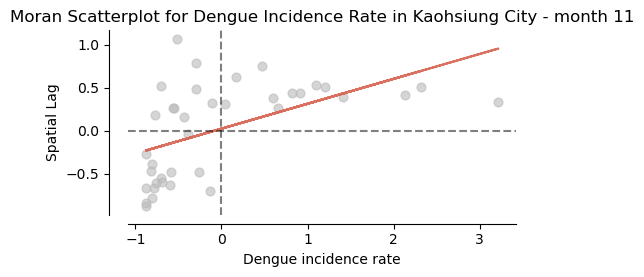

12
Moran's I for 12: 0.3282585706566109
Moran's I p-value for 12: 0.001

neighbour value: dict_values([[179, 191, 203, 215, 239, 251, 263, 275, 287, 299, 311, 323, 359, 371, 383, 443, 455], [35, 47, 71, 119, 383, 395, 407, 431, 443], [23, 47, 119, 131, 335, 431], [23, 35, 71, 119, 431], [71, 83, 95, 107, 203, 215, 227, 347, 371, 383, 395, 407, 419, 431], [23, 47, 59, 83, 95, 107, 215, 227, 347, 371, 383, 395, 407, 419, 431], [59, 71, 95, 107, 179, 191, 203, 215, 227, 239, 251, 263, 275, 347, 359, 371, 383, 395, 407, 419, 431], [59, 71, 83, 107, 191, 203, 215, 227, 347, 371, 383, 395, 407, 419, 431], [59, 71, 83, 95, 227, 347, 395, 407, 419, 431], [23, 35, 47, 131, 143], [35, 119, 143, 335], [119, 131, 155], [143, 167], [155], [11, 83, 191, 203, 215, 227, 239, 251, 263, 275, 287, 299, 311, 323, 359, 371, 383, 419, 443, 455], [11, 83, 95, 179, 203, 215, 227, 239, 251, 263, 275, 287, 299, 311, 323, 359, 371, 383, 395, 407, 419, 443], [11, 59, 83, 95, 179, 191, 215, 227, 239, 251, 263, 275

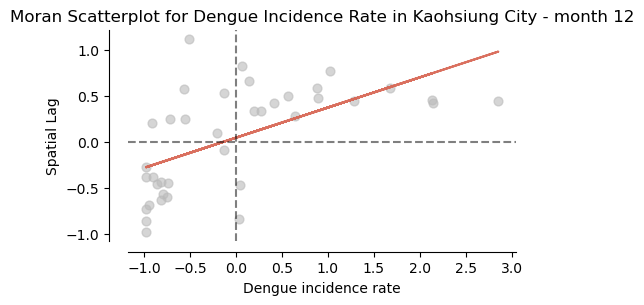

In [ ]:
for i in month_list:
    print(i)
    
    # filter the GeoDataFrame for the specific year
    gdf_month = ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i]
    
    # create a spatial weights matrix based on distance (20 km)
    w = DistanceBand.from_dataframe(gdf_month, threshold=20000, binary=True, silence_warnings=True)
    
    # calculate Moran's I
    mi = esda.Moran(gdf_month['dengue_rate'], w)
    
    print(f"Moran's I for {i}: {mi.I}")
    print(f"Moran's I p-value for {i}: {mi.p_sim}\n")
    
    print("neighbour value:", w.neighbors.values())
    # calculate number of neighbors for each area
    n_neighbors = pd.Series([len(neighbors) for neighbors in w.neighbors.values()], 
                        index=w.neighbors.keys())

    # calculate statistics
    mean_neighbors = n_neighbors.mean()
    min_neighbors = n_neighbors.min()
    max_neighbors = n_neighbors.max()

    print(f"Mean number of neighbors: {mean_neighbors:.2f}")
    print(f"Min number of neighbors: {min_neighbors}")
    print(f"Max number of neighbors: {max_neighbors}")
    
    fig, ax = plt.subplots(1, figsize=(5, 5))
    moran_scatterplot(mi, ax=ax)
    ax.set_title(f'Moran Scatterplot for Dengue Incidence Rate in Kaohsiung City - month {i}')
    ax.set_xlabel('Dengue incidence rate')
    ax.set_ylabel('Spatial Lag')
    plt.show()

#### Local

1
[0.001 0.02  0.049 0.096 0.02  0.019 0.116 0.071 0.007 0.095 0.019 0.054
 0.15  0.406 0.001 0.001 0.001 0.001 0.047 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.147 0.017 0.001 0.001 0.001 0.287 0.33  0.026 0.013
 0.001 0.001]
number of hotspot: 15


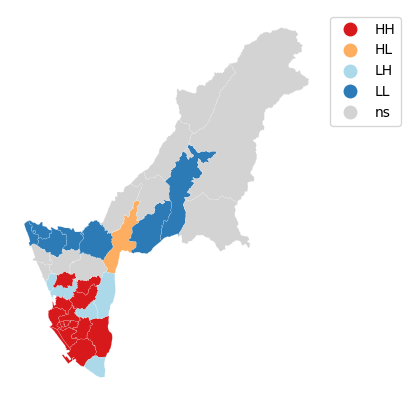

2
[0.001 0.057 0.188 0.246 0.093 0.012 0.086 0.37  0.041 0.246 0.32  0.424
 0.424 0.251 0.001 0.042 0.046 0.08  0.222 0.007 0.004 0.001 0.011 0.001
 0.001 0.001 0.001 0.431 0.072 0.002 0.058 0.229 0.353 0.097 0.229 0.007
 0.026 0.029]
number of hotspot: 7


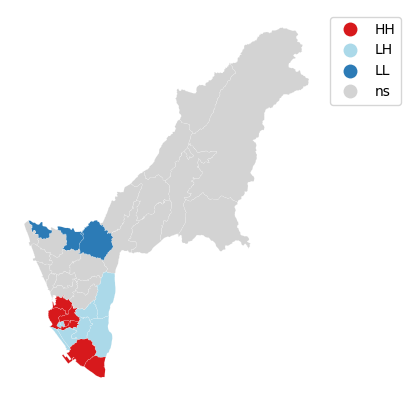

3
[0.004 0.001 0.001 0.001 0.081 0.067 0.442 0.067 0.001 0.001 0.001 0.001
 0.001 0.001 0.019 0.004 0.012 0.131 0.265 0.041 0.001 0.043 0.001 0.01
 0.001 0.01  0.045 0.001 0.195 0.004 0.004 0.243 0.186 0.486 0.243 0.057
 0.004 0.002]
number of hotspot: 5


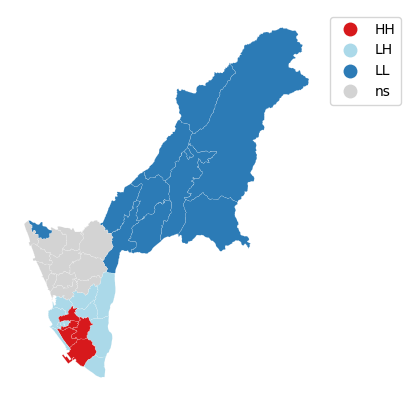

4
[0.002 0.318 0.471 0.468 0.141 0.12  0.431 0.295 0.001 0.468 0.392 0.304
 0.21  0.122 0.079 0.116 0.144 0.01  0.01  0.001 0.001 0.093 0.001 0.124
 0.058 0.011 0.149 0.2   0.352 0.012 0.007 0.08  0.468 0.118 0.007 0.084
 0.001 0.024]
number of hotspot: 0


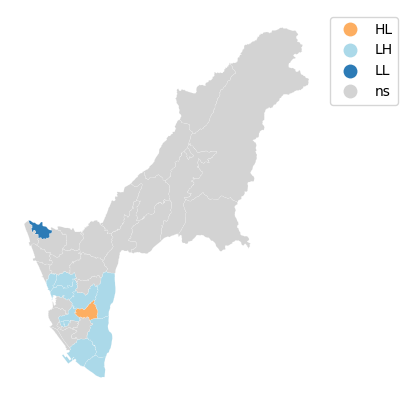

5
[0.007 0.163 0.001 0.001 0.382 0.437 0.413 0.37  0.001 0.001 0.473 0.412
 0.315 0.163 0.028 0.076 0.099 0.135 0.036 0.069 0.033 0.001 0.033 0.028
 0.028 0.001 0.024 0.295 0.202 0.033 0.071 0.035 0.447 0.406 0.071 0.438
 0.033 0.178]
number of hotspot: 2


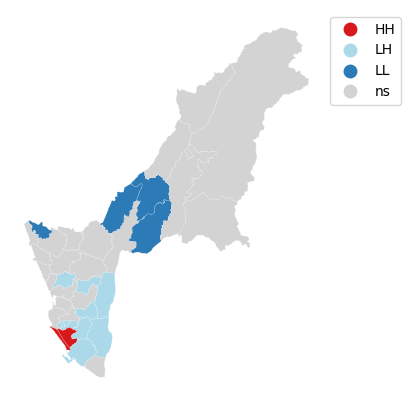

6
[0.002 0.051 0.001 0.001 0.214 0.07  0.157 0.191 0.053 0.001 0.001 0.001
 0.001 0.001 0.004 0.004 0.001 0.002 0.405 0.004 0.004 0.002 0.007 0.002
 0.002 0.001 0.003 0.001 0.057 0.002 0.001 0.156 0.145 0.14  0.372 0.038
 0.002 0.003]
number of hotspot: 8


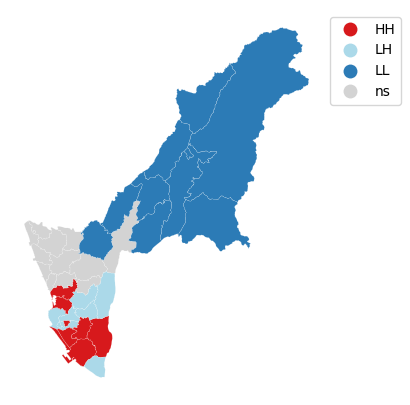

7
[0.001 0.011 0.049 0.072 0.013 0.006 0.331 0.018 0.003 0.072 0.07  0.144
 0.272 0.463 0.001 0.001 0.001 0.003 0.473 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.295 0.01  0.002 0.005 0.363 0.081 0.494 0.473 0.004
 0.001 0.001]
number of hotspot: 7


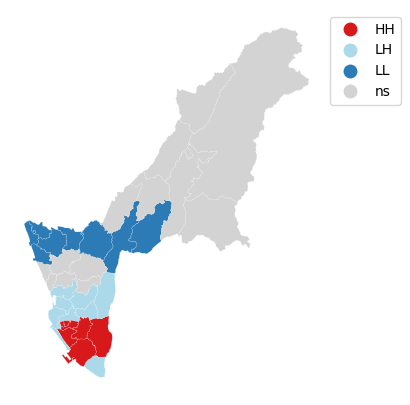

8
[0.001 0.009 0.024 0.111 0.013 0.007 0.234 0.018 0.003 0.069 0.003 0.005
 0.042 0.23  0.001 0.001 0.001 0.002 0.09  0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.102 0.027 0.001 0.002 0.046 0.222 0.127 0.08  0.011
 0.001 0.001]
number of hotspot: 9


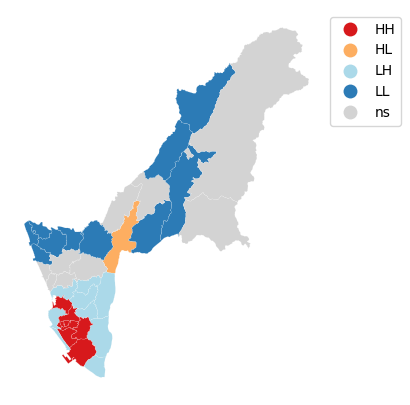

9
[0.001 0.008 0.027 0.073 0.01  0.004 0.17  0.02  0.003 0.14  0.024 0.042
 0.191 0.174 0.002 0.002 0.002 0.004 0.014 0.002 0.002 0.001 0.002 0.001
 0.001 0.001 0.001 0.166 0.041 0.001 0.002 0.015 0.328 0.205 0.012 0.006
 0.001 0.001]
number of hotspot: 11


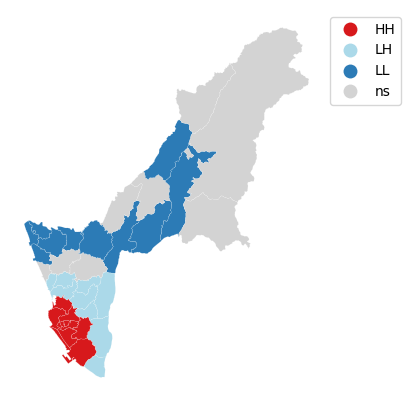

10
[0.001 0.013 0.06  0.036 0.013 0.002 0.093 0.048 0.001 0.038 0.038 0.07
 0.011 0.322 0.001 0.001 0.001 0.001 0.006 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.135 0.009 0.001 0.002 0.006 0.425 0.188 0.01  0.001
 0.001 0.001]
number of hotspot: 12


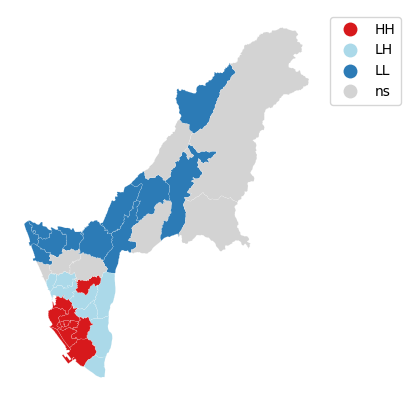

11
[0.001 0.041 0.052 0.039 0.023 0.007 0.135 0.057 0.001 0.048 0.086 0.018
 0.014 0.089 0.001 0.001 0.001 0.001 0.009 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.12  0.004 0.001 0.001 0.002 0.36  0.156 0.007 0.004
 0.001 0.001]
number of hotspot: 13


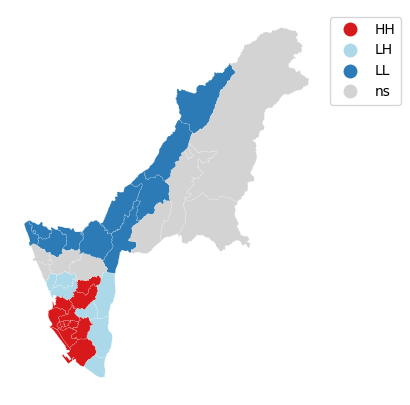

12
[0.001 0.047 0.042 0.044 0.023 0.011 0.107 0.058 0.001 0.121 0.018 0.116
 0.072 0.118 0.001 0.001 0.001 0.001 0.019 0.001 0.001 0.001 0.001 0.001
 0.001 0.001 0.001 0.31  0.001 0.001 0.001 0.005 0.265 0.284 0.016 0.008
 0.001 0.001]
number of hotspot: 15


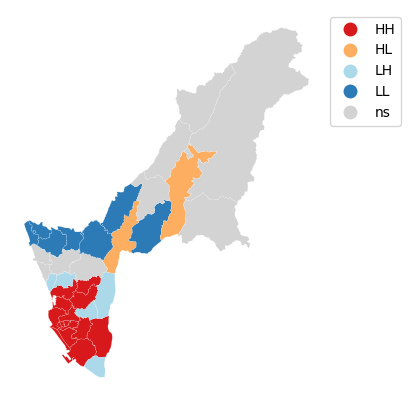

In [97]:
# calculate Moran_Local and plot
for i in month_list:
    print(i)
    # filter the GeoDataFrame for the specific year
    gdf_month = ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i]
    
    # create a spatial weights matrix based on distance (20 km)
    w = DistanceBand.from_dataframe(gdf_month, threshold=20000, binary=True, silence_warnings=True)
    
    # calculate Moran's I    
    moran_loc = Moran_Local(gdf_month['dengue_rate'], w)
    town_temp_list = gdf_month['name_en'].to_list()
    print(moran_loc.p_sim)
    for j in range(len(moran_loc.q)):
        if moran_loc.p_sim[j] < 0.05:
            ks_analysis_monthly_gdf.loc[(ks_analysis_monthly_gdf['month_infected'] == i) & (ks_analysis_monthly_gdf['name_en'] == town_temp_list[j]), 'moran_q_distance'] = moran_loc.q[j]
        else:
            ks_analysis_monthly_gdf.loc[(ks_analysis_monthly_gdf['month_infected'] == i) & (ks_analysis_monthly_gdf['name_en'] == town_temp_list[j]), 'moran_q_distance'] = 0
    
    print("number of hotspot:", ks_analysis_monthly_gdf[(ks_analysis_monthly_gdf['month_infected']==i)&(ks_analysis_monthly_gdf['moran_q_distance']==1)].shape[0])
    
    lisa_cluster(moran_loc, 
                 ks_analysis_monthly_gdf[ks_analysis_monthly_gdf['month_infected'] == i], 
                 p=0.05, 
                 figsize=(5, 5),
                 legend_kwds={'loc': 'upper left', 'bbox_to_anchor': (1, 1)})
    plt.show()

# Part 3: An assessment of the utility of entomological indices in dengue surveillance systems (correlation analysis)

In [98]:
indices_data_path = './data/MosIndex_Kaohsiung.csv'

In [99]:
indices_gdf = gpd.read_file(indices_data_path)

In [100]:
indices_gdf['Date'] = pd.to_datetime(indices_gdf['Date'])
indices_gdf['month_survey'] = indices_gdf['Date'].dt.month
indices_gdf['year_survey'] = indices_gdf['Date'].dt.year
indices_gdf['week_survey'] = indices_gdf['Date'].dt.isocalendar().week
# add week start date
indices_gdf['week_start'] = indices_gdf['Date'] - pd.to_timedelta(indices_gdf['Date'].dt.dayofweek, unit='D')
indices_gdf['year_start'] = indices_gdf['week_start'].dt.year

In [101]:
indices_gdf.head()

,Date,County,Town,Village,VillageID,VillageLon,VillageLat,AreaType,HouseHold,InspectType,...,LI,LILv,Pupa,AI,Con100HH,month_survey,year_survey,week_survey,week_start,year_start
0,2010-01-02,高雄市,鳳山區,生明里,6401200-045,120.36306711902,22.6176350677023,住宅,60,監測,...,0.000,0,0,0.0333,3.33,1,2010,53,2009-12-28,2009
1,2010-01-03,高雄市,鳳山區,福誠里,6401200-049,120.324306140127,22.5946341776127,住宅,57,監測,...,0.000,0,0,0.0000,0.00,1,2010,53,2009-12-28,2009
2,2010-01-04,高雄市,橋頭區,芋寮里,6402000-005,120.282231759346,22.7594772337332,其他,100,監測,...,0.000,0,0,0.0000,0.00,1,2010,1,2010-01-04,2010
3,2010-01-04,高雄市,鳳山區,福誠里,6401200-049,120.324306140127,22.5946341776127,學校,50,監測,...,0.000,0,0,0.0000,0.00,1,2010,1,2010-01-04,2010
4,2010-01-04,高雄市,鳳山區,海洋里,6401200-065,120.34719367836,22.6127133290113,住宅,50,監測,...,4.000,2,0,0.0000,2.00,1,2010,1,2010-01-04,2010


In [102]:
selected_indices_gdf = indices_gdf[(indices_gdf['year_survey']>=2011) & (indices_gdf['year_survey']<=2016)]

In [103]:
selected_indices_gdf.head()

,Date,County,Town,Village,VillageID,VillageLon,VillageLat,AreaType,HouseHold,InspectType,...,LI,LILv,Pupa,AI,Con100HH,month_survey,year_survey,week_survey,week_start,year_start
12984,2011-01-01,高雄市,鳳山區,南和里,6401200-076,120.333563994491,22.5953498984305,住宅,100,監測,...,20.000,3,0,0.0000,1.00,1,2011,52,2010-12-27,2010
12985,2011-01-03,高雄市,三民區,鳳南里,6400500-077,120.292402338236,22.6355979409433,住宅,277,公服,...,21.660,3,0,0.0000,2.16,1,2011,1,2011-01-03,2011
12986,2011-01-03,高雄市,三民區,本元里,6400500-012,120.334434087446,22.6525432528511,住宅,198,公服,...,11.616,3,0,0.0000,1.51,1,2011,1,2011-01-03,2011
12987,2011-01-03,高雄市,三民區,本武里,6400500-011,120.332045986979,22.6510113593216,住宅,289,公服,...,13.840,3,0,0.0000,0.69,1,2011,1,2011-01-03,2011
12988,2011-01-03,高雄市,苓雅區,福康里,6400800-052,120.330697363937,22.6196109133775,學校,50,監測,...,0.000,0,0,0.0000,0.00,1,2011,1,2011-01-03,2011


In [104]:
selected_indices_gdf = selected_indices_gdf[selected_indices_gdf['Village']!='None']

In [105]:
# create a geometry column from latitude and longitude
geometry = [Point(xy) for xy in zip(selected_indices_gdf['VillageLon'], selected_indices_gdf['VillageLat'])]
selected_indices_gdf = gpd.GeoDataFrame(selected_indices_gdf, geometry=geometry)
selected_indices_gdf = selected_indices_gdf.set_crs(epsg=4326, allow_override=True)
selected_indices_gdf = selected_indices_gdf.to_crs(epsg=3826)

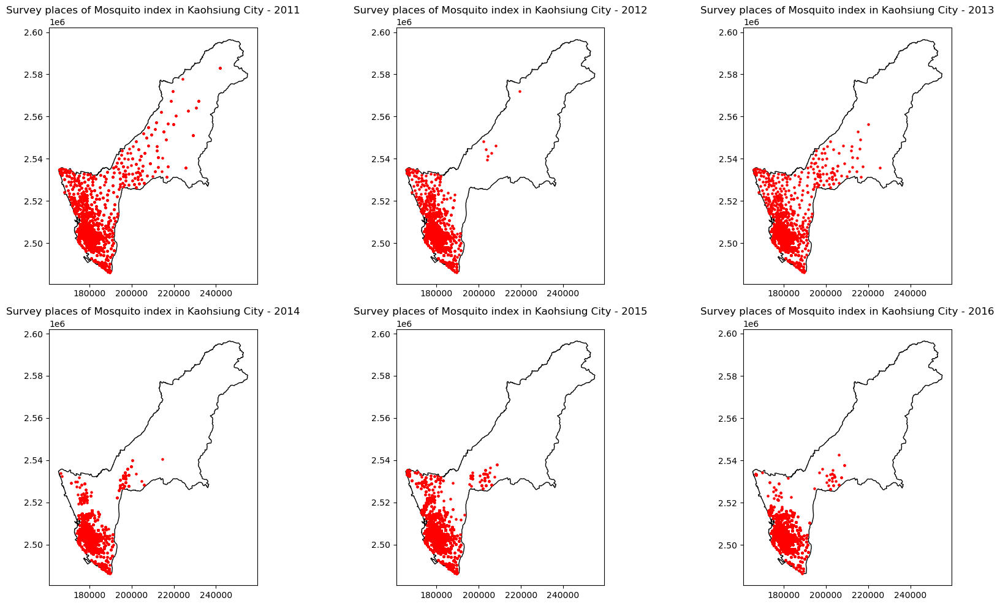

In [ ]:
# get unique years from the data
years = selected_indices_gdf['year_survey'].unique()

fig, axes = plt.subplots(2, 3, figsize=(18, 10))
# flatten the axes array for easy iteration
axes = axes.flatten()

# create a plot for each year
for i, year in enumerate(years):
    temp_gdf = selected_indices_gdf[selected_indices_gdf['year_survey'] == year]
    
    # plot the boundary and points on the same axis
    boundary_gdf.plot(ax=axes[i], edgecolor='black', facecolor='none')  # plot the boundary
    temp_gdf.plot(ax=axes[i], marker='o', color='red', markersize=5)  # plot the points
    
    axes[i].set_title(f'Survey places of Mosquito index in Kaohsiung City - {year}')

plt.tight_layout()
plt.show()

In [107]:
print('InspectType:', selected_indices_gdf['InspectType'].unique())
print('AreaType:', selected_indices_gdf['AreaType'].unique())
print('Town:', selected_indices_gdf['Town'].unique())

InspectType: ['監測' '公服' '衛生局' '衛生所' '疾病管制署' '其他']
AreaType: ['住宅' '學校' '公園' '空地' '其他' '市場' '機關' '空屋']
Town: ['鳳山區' '三民區' '苓雅區' '鹽埕區' '前鎮區' '楠梓區' '林園區' '左營區' '鼓山區' '小港區' '新興區' '大樹區'
 '旗津區' '茄萣區' '湖內區' '梓官區' '橋頭區' '仁武區' '路竹區' '鳥松區' '岡山區' '彌陀區' '大寮區' '永安區'
 '阿蓮區' '大社區' '燕巢區' '旗山區' '田寮區' '甲仙區' '杉林區' '桃源區' '內門區' '茂林區' '六龜區' '美濃區'
 '前金區' '那瑪夏區']


## Calculate HI, CI, BI, LI, and PI monthly

In [108]:
selected_indices_gdf.columns

Index(['Date', 'County', 'Town', 'Village', 'VillageID', 'VillageLon',
       'VillageLat', 'AreaType', 'HouseHold', 'InspectType', 'PosHH',
       'PosHHAeg', 'ConIn', 'ConOut', 'ConAll', 'PosConIn', 'PosConOut',
       'PosConAll', 'FAegIn', 'FAegOut', 'FAlbIn', 'FAlbOut', 'LarvaAeg',
       'LarvaAlb', 'LarvaNEC', 'PI', 'BI', 'BILv', 'AIAeg', 'AIAlb', 'HI',
       'HIAeg', 'HILv', 'HILvAeg', 'CI', 'CILv', 'LI', 'LILv', 'Pupa', 'AI',
       'Con100HH', 'month_survey', 'year_survey', 'week_survey', 'week_start',
       'year_start', 'geometry'],
      dtype='object')

In [109]:
def calculate_indices(group):
    group['PosConAll'] = group['PosConAll'].astype(float)
    group['ConAll'] = group['ConAll'].astype(float)
    group['HouseHold'] = group['HouseHold'].astype(float)
    group['PosHH'] = group['PosHH'].astype(float)
    group['Pupa'] = group['Pupa'].astype(float)
    group['LarvaAeg'] = group['LarvaAeg'].astype(float)
    group['LarvaAlb'] = group['LarvaAlb'].astype(float)
    group['LarvaNEC'] = group['LarvaNEC'].astype(float)
    group['FAegIn'] = group['FAegIn'].astype(float)
    group['FAegOut'] = group['FAegOut'].astype(float)
    group['FAlbIn'] = group['FAlbIn'].astype(float)
    group['FAlbOut'] = group['FAlbOut'].astype(float)
    ci_new = (sum(group['PosConAll'])/sum(group['ConAll']))*100
    hi_new = (sum(group['PosHH'])/sum(group['HouseHold']))*100
    pi_new = (sum(group['Pupa'])/sum(group['HouseHold']))*100
    bi_new = (sum(group['PosConAll'])/sum(group['HouseHold']))*100
    li_new = ((sum(group['LarvaAeg'])+sum(group['LarvaAlb'])+sum(group['LarvaNEC']))/sum(group['HouseHold']))*100
    ai_new = ((sum(group['FAegIn'])+sum(group['FAegOut'])+sum(group['FAlbIn'])+sum(group['FAlbOut']))/sum(group['HouseHold']))*100
    return ci_new, hi_new, pi_new, bi_new, li_new, ai_new

In [110]:
month_selected_indices_gdf = indices_gdf[(indices_gdf['year_survey']>=2011) & (indices_gdf['year_survey']<=2016)]

In [111]:
grouped_df = month_selected_indices_gdf.groupby(['year_survey', 'month_survey']).apply(calculate_indices).reset_index()

/tmp/ipykernel_965/4048621042.py:1: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [112]:
grouped_df

,year_survey,month_survey,0
0,2011,1,"(3.3507831650670985, 1.7181821684023986, 0.234..."
1,2011,2,"(1.963402852758993, 0.8946509291813158, 0.3390..."
2,2011,3,"(2.201562968581862, 1.0924411897477053, 0.4955..."
3,2011,4,"(2.342059953202949, 1.360887845607571, 0.51404..."
4,2011,5,"(3.7040237334024595, 2.4473983343772474, 1.547..."
...,...,...,...
67,2016,8,"(8.645549184434671, 3.654979122576217, 0.20019..."
68,2016,9,"(9.699812382739212, 3.716090672612412, 0.02477..."
69,2016,10,"(10.543165083769075, 3.2190097155565964, 0.015..."
70,2016,11,"(6.066734074823053, 1.9504908237302603, 0.0, 2..."


In [113]:
# split the result into separate columns for mean, CI, and additional value
grouped_df[['ci', 'hi', 'pi', 'bi', 'li', 'ai']] = pd.DataFrame(grouped_df[0].tolist(), index=grouped_df.index)

# drop the original column
grouped_df = grouped_df.drop(columns=[0])

In [114]:
grouped_df

,year_survey,month_survey,ci,hi,pi,bi,li,ai
0,2011,1,3.350783,1.718182,0.234998,2.071321,19.420081,0.354423
1,2011,2,1.963403,0.894651,0.339026,1.084568,11.886301,0.197765
2,2011,3,2.201563,1.092441,0.495561,1.251944,14.502683,0.328033
3,2011,4,2.342060,1.360888,0.514047,1.576312,15.929519,0.640330
4,2011,5,3.704024,2.447398,1.547313,2.983274,24.833554,0.909365
...,...,...,...,...,...,...,...,...
67,2016,8,8.645549,3.654979,0.200194,4.441457,48.784534,0.268833
68,2016,9,9.699812,3.716091,0.024774,4.269375,37.986705,0.400512
69,2016,10,10.543165,3.219010,0.015607,3.855008,31.581412,0.226306
70,2016,11,6.066734,1.950491,0.000000,2.176697,16.370038,0.510030


In [115]:
month_selected_indices_gdf['PI'] = month_selected_indices_gdf['PI'].replace('None', 0)

/tmp/ipykernel_965/1553280658.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [116]:
month_selected_indices_gdf['PI'] = month_selected_indices_gdf['PI'].astype(float)
month_selected_indices_gdf['BI'] = month_selected_indices_gdf['BI'].astype(float)
month_selected_indices_gdf['HI'] = month_selected_indices_gdf['HI'].astype(float)
month_selected_indices_gdf['CI'] = month_selected_indices_gdf['CI'].astype(float)
month_selected_indices_gdf['LI'] = month_selected_indices_gdf['LI'].astype(float)
month_selected_indices_gdf['AI'] = month_selected_indices_gdf['AI'].astype(float)

/tmp/ipykernel_965/2023375034.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/2023375034.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/2023375034.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/202

In [117]:
# month_selected_indices_gdf.loc[:, 'PI'] = month_selected_indices_gdf['PI'].replace('None', 0)

In [118]:
# month_selected_indices_gdf.loc[:, 'PI'] = month_selected_indices_gdf['PI'].astype(float)
# month_selected_indices_gdf.loc[:, 'BI'] = month_selected_indices_gdf['BI'].astype(float)
# month_selected_indices_gdf.loc[:, 'HI'] = month_selected_indices_gdf['HI'].astype(float)
# month_selected_indices_gdf.loc[:, 'CI'] = month_selected_indices_gdf['CI'].astype(float)
# month_selected_indices_gdf.loc[:, 'LI'] = month_selected_indices_gdf['LI'].astype(float)
# month_selected_indices_gdf.loc[:, 'AI'] = month_selected_indices_gdf['AI'].astype(float)

In [119]:
grouped_df_new = month_selected_indices_gdf.groupby(['year_survey', 'month_survey'])[['PI', 'BI', 'HI', 'CI', 'LI', 'AI']].mean().reset_index()

## Calculate entomological indices weekly

In [120]:
week_selected_indices_gdf = indices_gdf[(indices_gdf['year_start']>=2011) & (indices_gdf['year_start']<=2016)]

In [121]:
week_selected_indices_gdf.head()

,Date,County,Town,Village,VillageID,VillageLon,VillageLat,AreaType,HouseHold,InspectType,...,LI,LILv,Pupa,AI,Con100HH,month_survey,year_survey,week_survey,week_start,year_start
12985,2011-01-03,高雄市,三民區,鳳南里,6400500-077,120.292402338236,22.6355979409433,住宅,277,公服,...,21.660,3,0,0.0000,2.16,1,2011,1,2011-01-03,2011
12986,2011-01-03,高雄市,三民區,本元里,6400500-012,120.334434087446,22.6525432528511,住宅,198,公服,...,11.616,3,0,0.0000,1.51,1,2011,1,2011-01-03,2011
12987,2011-01-03,高雄市,三民區,本武里,6400500-011,120.332045986979,22.6510113593216,住宅,289,公服,...,13.840,3,0,0.0000,0.69,1,2011,1,2011-01-03,2011
12988,2011-01-03,高雄市,苓雅區,福康里,6400800-052,120.330697363937,22.6196109133775,學校,50,監測,...,0.000,0,0,0.0000,0.00,1,2011,1,2011-01-03,2011
12989,2011-01-03,高雄市,苓雅區,福康里,6400800-052,120.330697363937,22.6196109133775,住宅,283,監測,...,13.074,3,0,0.0035,1.76,1,2011,1,2011-01-03,2011


In [122]:
grouped_week_df = week_selected_indices_gdf.groupby(['year_start', 'week_survey']).apply(calculate_indices).reset_index()

/tmp/ipykernel_965/2916827589.py:1: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [123]:
# split the result into separate columns for mean, CI, and additional value
grouped_week_df[['ci', 'hi', 'pi', 'bi', 'li', 'ai']] = pd.DataFrame(grouped_week_df[0].tolist(), index=grouped_week_df.index)

# drop the original column
grouped_week_df = grouped_week_df.drop(columns=[0])

In [124]:
grouped_week_df

,year_start,week_survey,ci,hi,pi,bi,li,ai
0,2011,1,2.382010,1.306887,0.056976,1.527669,13.724094,0.238587
1,2011,2,3.535512,1.971946,0.035576,2.287050,21.864200,0.345599
2,2011,3,3.594368,1.730861,0.129986,1.990833,19.326811,0.417322
3,2011,4,5.117877,2.320522,0.986222,3.132705,29.289340,0.572879
4,2011,5,0.988320,0.442870,0.221435,0.487157,4.118689,0.088574
...,...,...,...,...,...,...,...,...
306,2016,48,5.797858,2.098327,0.000000,2.250380,15.924987,1.003548
307,2016,49,7.521153,2.027590,0.000000,2.222016,15.137487,0.203685
308,2016,50,8.060556,2.104723,0.064168,2.528234,18.557495,0.243840
309,2016,51,3.947368,1.272296,0.000000,1.347137,10.016216,0.112261


In [125]:
week_selected_indices_gdf['PI'] = week_selected_indices_gdf['PI'].replace('None', 0)

/tmp/ipykernel_965/3545059920.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [126]:
week_selected_indices_gdf['PI'] = week_selected_indices_gdf['PI'].astype(float)
week_selected_indices_gdf['BI'] = week_selected_indices_gdf['BI'].astype(float)
week_selected_indices_gdf['HI'] = week_selected_indices_gdf['HI'].astype(float)
week_selected_indices_gdf['CI'] = week_selected_indices_gdf['CI'].astype(float)
week_selected_indices_gdf['LI'] = week_selected_indices_gdf['LI'].astype(float)
week_selected_indices_gdf['AI'] = week_selected_indices_gdf['AI'].astype(float)

/tmp/ipykernel_965/843217427.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/843217427.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/843217427.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/843217

In [127]:
grouped_week_df_new = week_selected_indices_gdf.groupby(['year_start', 'week_survey'])[['PI', 'BI', 'HI', 'CI', 'LI', 'AI']].mean().reset_index()

### EDA of area type

In [128]:
def map_area_type(row):
    if row['AreaType'] == '住宅':
        return 'Residential'
    elif row['AreaType'] == '學校':
        return 'School'
    elif row['AreaType'] == '公園':
        return 'Park'
    elif row['AreaType'] == '空地':
        return 'Vacant land'
    elif row['AreaType'] == '其他':
        return 'Others'
    elif row['AreaType'] == '市場':
        return 'Market'
    elif row['AreaType'] == '機關':
        return 'Institution'
    elif row['AreaType'] == '空屋':
        return 'Vacant house'

In [129]:
month_selected_indices_gdf['AreaType_en'] = month_selected_indices_gdf.apply(map_area_type, axis=1)

/tmp/ipykernel_965/2582071256.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [130]:
# area_group_df = selected_indices_gdf.groupby(['AreaType_en', 'year_survey', 'month_survey']).apply(calculate_indices).reset_index()

In [131]:
# area_group_df = selected_indices_gdf.groupby(['year_survey','AreaType_en'])[['BI', 'HI', 'CI', 'LI', 'AI']].mean().reset_index()
area_group_df = month_selected_indices_gdf.groupby('AreaType_en')[['PI', 'BI', 'HI', 'CI', 'LI', 'AI']].mean().reset_index()

In [132]:
area_group_df

,AreaType_en,PI,BI,HI,CI,LI,AI
0,Institution,0.000000,1.596125,0.721125,5.392500,6.134500,0.001250
1,Market,0.303191,1.470436,1.278947,5.693782,16.262191,0.000798
2,Others,0.000000,4.232757,3.414871,21.785193,76.664744,0.000587
3,Park,0.010000,0.134770,0.134770,1.830930,0.629920,0.000983
4,Residential,0.360744,4.010599,3.255899,6.893467,38.528790,0.006656
5,School,0.024845,1.118084,0.957273,4.651453,6.453065,0.000776
6,Vacant house,0.000000,1.333000,1.333000,1.851000,9.333000,0.000000
7,Vacant land,0.000000,3.428571,1.428571,7.414000,41.142857,0.000000


In [133]:
# melt the DataFrame to long format
area_group_melted_df = area_group_df.melt(id_vars='AreaType_en', var_name='Index', value_name='Value')

In [134]:
area_group_melted_df.head()

,AreaType_en,Index,Value
0,Institution,PI,0.000000
1,Market,PI,0.303191
2,Others,PI,0.000000
3,Park,PI,0.010000
4,Residential,PI,0.360744


In [135]:
# # Split the result into separate columns for mean, CI, and additional value
# area_group_df[['ci', 'hi', 'bi', 'li', 'ai']] = pd.DataFrame(area_group_df[0].tolist(), index=area_group_df.index)

# # Drop the original column
# area_group_df = area_group_df.drop(columns=[0])

In [136]:
# area_group_df.head()

In [137]:
# area_group_df['year_month'] = area_group_df['year_survey'].astype(str) + '-' + area_group_df['month_survey'].astype(str).str.zfill(2)

In [138]:
# area_group_df.head()

In [139]:
# # Melt the DataFrame to long format
# df_long = area_group_df.melt(id_vars=['year_survey', 'AreaType_en'], value_vars=['CI'], var_name='Variable', value_name='Value')

# # Create an interactive line plot
# fig = px.line(df_long, x='year_survey', y='Value', color='AreaType_en', markers=True, title='Interactive Line Plot of Value1 and Value2')

# # Show the plot
# fig.show()

In [140]:
fig = px.bar(area_group_melted_df, x='Value', y='Index', color='AreaType_en',
             barmode='group',
             orientation='h',
             category_orders=category_orders,
             title='Mean value of Entomological indices by Area Type')

fig.show()

In [141]:
fig = px.bar(area_group_melted_df[area_group_melted_df['Index']=='AI'], x='Value', y='Index', color='AreaType_en',
             barmode='group',
             orientation='h',
             category_orders=category_orders,
             title='AI by Area Type')

fig.show()

In [142]:
fig = px.bar(area_group_melted_df[area_group_melted_df['Index']=='PI'], x='Value', y='Index', color='AreaType_en',
             barmode='group',
             orientation='h',
             category_orders=category_orders,
             title='PI by Area Type')

fig.show()

## Find correlation (monthly)

### Summarize the dengue cases (monthly)

In [143]:
sum_dengue_case_df = final_ks_gdf.groupby(['year_infected', 'month_infected']).size().reset_index(name='count')

### Define common function for finding correlation and plot the graph

In [144]:
def find_corr(df, column_list):
    corr_matrix = df[column_list].corr()
    print(corr_matrix)
    
    # create pairplot with regression lines
    g = sns.pairplot(df[column_list],
                     diag_kind='kde',
                     kind='reg',
                     plot_kws={'line_kws':{'color':'red'}},
                     height=2)

    # add correlation coefficients to each subplot
    for i in range(len(column_list)):
        for j in range(len(column_list)):
            if i != j:
                ax = g.axes[i][j]
                corr = corr_matrix.iloc[i,j]
                ax.text(0.05, 0.95, f'r={corr:.2f}',
                    transform=ax.transAxes,
                    bbox=dict(facecolor='white', alpha=0.8))

    plt.tight_layout()
    plt.show()

### Correlation between entomological indices and dengue cases (monthly)

In [145]:
corr_df_test = grouped_df_new.merge(sum_dengue_case_df, left_on=['year_survey', 'month_survey'], right_on=['year_infected', 'month_infected'], how='left')

In [146]:
corr_df_test['count'] = corr_df_test['count'].fillna(0)

In [147]:
# corr_df_test2 = corr_df_test.dropna()

In [148]:
columns = ['PI', 'BI', 'HI', 'CI', 'LI', 'AI', 'count']

In [149]:
for col in columns:
    corr_df_test[col] = corr_df_test[col].astype(float)

In [150]:
corr_df_test.dtypes

year_survey         int32
month_survey        int32
PI                float64
BI                float64
HI                float64
CI                float64
LI                float64
AI                float64
year_infected     float64
month_infected    float64
count             float64
dtype: object

             PI        BI        HI        CI        LI        AI     count
PI     1.000000  0.379677  0.350681  0.234809  0.325764  0.398209  0.133293
BI     0.379677  1.000000  0.996523  0.862267  0.945038  0.707572 -0.200331
HI     0.350681  0.996523  1.000000  0.869139  0.941452  0.693458 -0.204134
CI     0.234809  0.862267  0.869139  1.000000  0.751045  0.461663 -0.060935
LI     0.325764  0.945038  0.941452  0.751045  1.000000  0.752848 -0.246542
AI     0.398209  0.707572  0.693458  0.461663  0.752848  1.000000 -0.269358
count  0.133293 -0.200331 -0.204134 -0.060935 -0.246542 -0.269358  1.000000


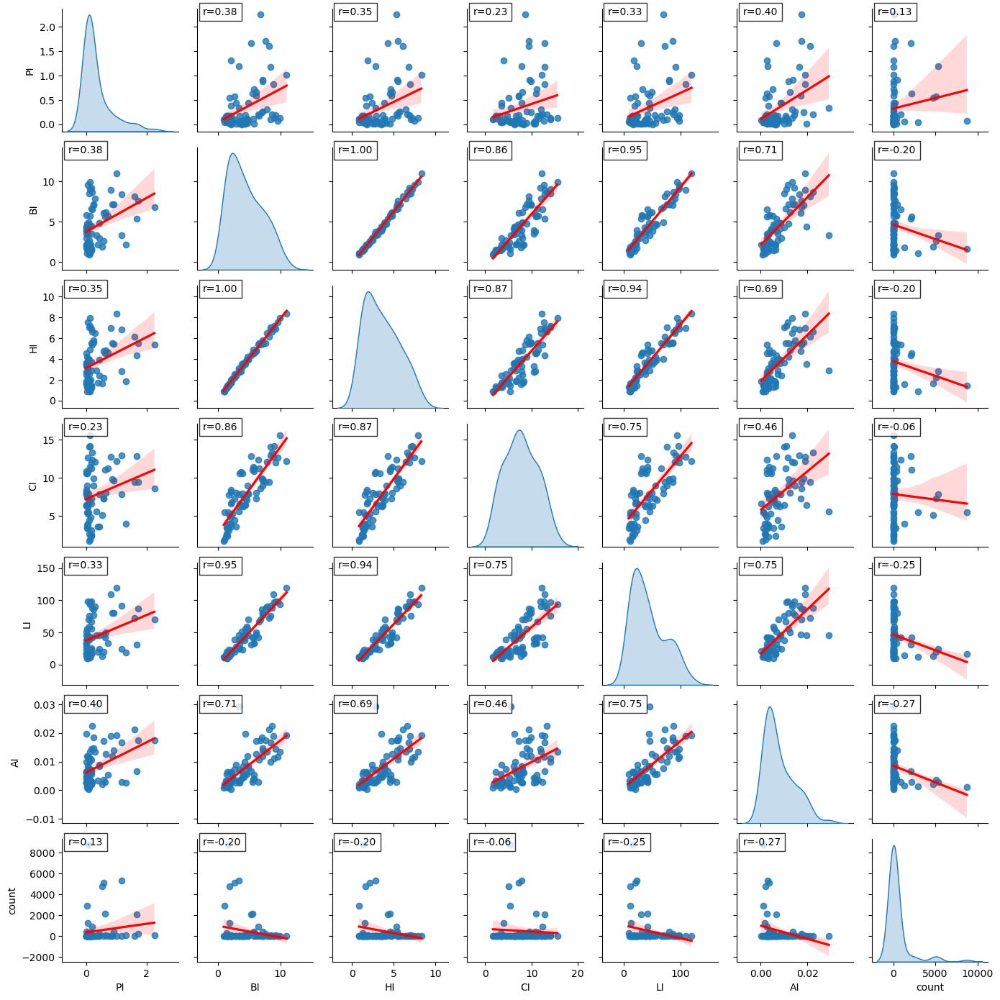

In [151]:
find_corr(corr_df_test, columns)

In [152]:
# corr_df_test[['PI', 'CI', 'HI', 'BI', 'LI', 'AI', 'count']].corr()

In [153]:
corr_df_test[corr_df_test['count']==corr_df_test['count'].max()]   

,year_survey,month_survey,PI,BI,HI,CI,LI,AI,year_infected,month_infected,count
58,2015,11,0.074043,1.606877,1.401749,5.443357,16.173029,0.001116,2015.0,11.0,8741.0


#### One month lag correlation

In [154]:
corr_df_test['pi_shifted'] = corr_df_test['PI'].shift(1)
corr_df_test['ci_shifted'] = corr_df_test['CI'].shift(1)
corr_df_test['hi_shifted'] = corr_df_test['HI'].shift(1)
corr_df_test['bi_shifted'] = corr_df_test['BI'].shift(1)
corr_df_test['li_shifted'] = corr_df_test['LI'].shift(1)
corr_df_test['ai_shifted'] = corr_df_test['AI'].shift(1)

In [155]:
# corr_df_shifted2 = corr_df_test.dropna()

In [156]:
corr_df_test.head()

,year_survey,month_survey,PI,BI,HI,CI,LI,AI,year_infected,month_infected,count,pi_shifted,ci_shifted,hi_shifted,bi_shifted,li_shifted,ai_shifted
0,2011,1,0.383178,2.145727,1.712273,3.514875,19.655267,0.003402,2011.0,1.0,10.0,NaN,NaN,NaN,NaN,NaN,NaN
1,2011,2,0.118325,1.065784,0.864028,1.846545,10.181885,0.002040,2011.0,2.0,2.0,0.383178,3.514875,1.712273,2.145727,19.655267,0.003402
2,2011,3,0.156551,1.330188,1.160446,2.229359,15.253068,0.003301,NaN,NaN,0.0,0.118325,1.846545,0.864028,1.065784,10.181885,0.002040
3,2011,4,0.167640,1.565059,1.345499,2.308219,15.805565,0.006405,NaN,NaN,0.0,0.156551,2.229359,1.160446,1.330188,15.253068,0.003301
4,2011,5,0.441250,2.932054,2.420251,3.524541,24.382860,0.008954,NaN,NaN,0.0,0.167640,2.308219,1.345499,1.565059,15.805565,0.006405


In [157]:
corr_df_test = corr_df_test.dropna(subset=['pi_shifted', 'ci_shifted', 'hi_shifted', 'bi_shifted', 'li_shifted', 'ai_shifted'])

In [158]:
columns = ['pi_shifted', 'ci_shifted', 'hi_shifted', 'bi_shifted', 'li_shifted', 'ai_shifted', 'count']

In [159]:
for col in columns:
    corr_df_test[col] = corr_df_test[col].astype(float)

            pi_shifted  ci_shifted  hi_shifted  bi_shifted  li_shifted  \
pi_shifted    1.000000    0.235378    0.344580    0.373906    0.319233   
ci_shifted    0.235378    1.000000    0.875221    0.868240    0.756621   
hi_shifted    0.344580    0.875221    1.000000    0.996473    0.940568   
bi_shifted    0.373906    0.868240    0.996473    1.000000    0.944215   
li_shifted    0.319233    0.756621    0.940568    0.944215    1.000000   
ai_shifted    0.393556    0.463566    0.690084    0.704374    0.750172   
count         0.268925    0.146680   -0.034581   -0.035612   -0.162256   

            ai_shifted     count  
pi_shifted    0.393556  0.268925  
ci_shifted    0.463566  0.146680  
hi_shifted    0.690084 -0.034581  
bi_shifted    0.704374 -0.035612  
li_shifted    0.750172 -0.162256  
ai_shifted    1.000000 -0.211996  
count        -0.211996  1.000000  


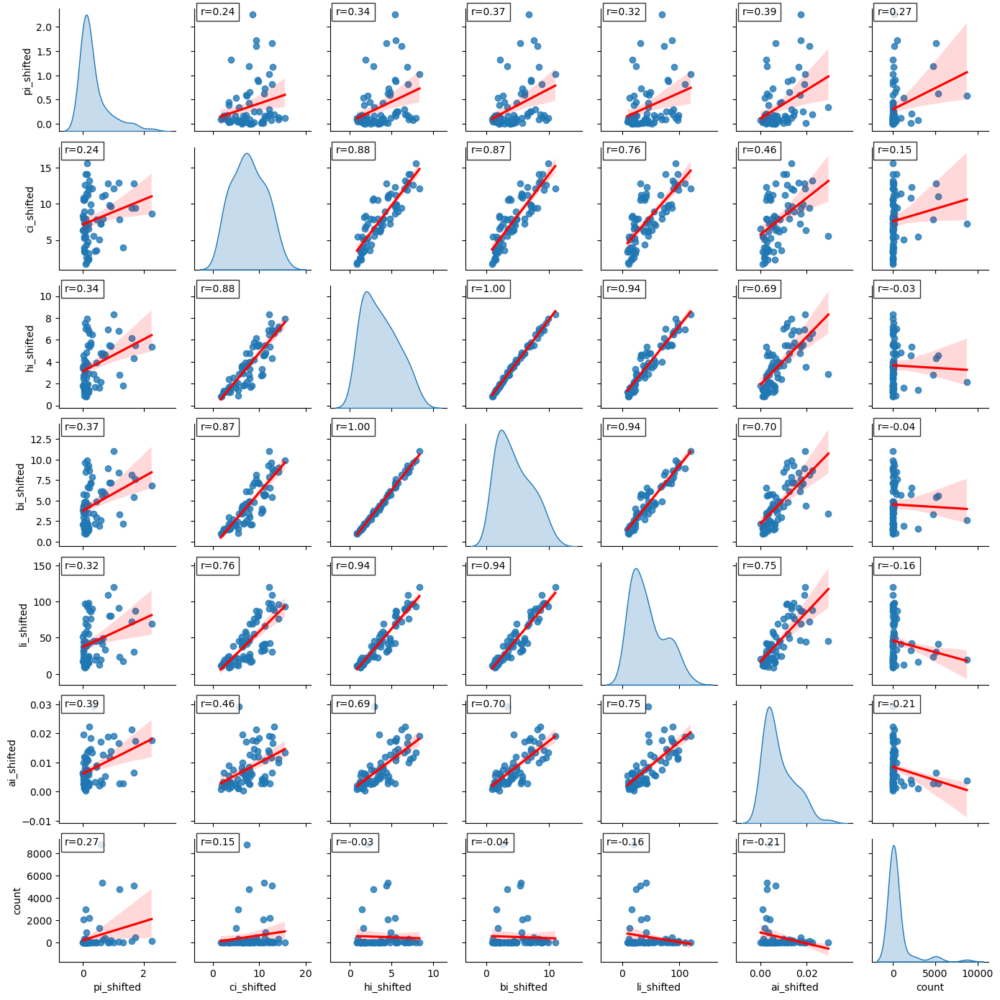

In [160]:
find_corr(corr_df_test, columns)

## Find correlation (weekly)

### Summarize the dengue cases (weekly)

In [161]:
final_ks_gdf.columns

Index(['Date_Onset', 'Date_Confirmation', 'Date_Notification', 'Sex',
       'Age_Group', 'County_living', 'Township_living', 'Village_Living',
       'Village_Living_Code', 'Enumeration_unit',
       ...
       'name:zh-Latn-tongyong', 'nat_ref', 'population', 'type', 'wikidata',
       'wikipedia', 'wikipedia:hak', 'wikipedia:nan', 'wikipedia:szy',
       'wikipedia:zh'],
      dtype='object', length=124)

In [162]:
final_ks_gdf['week_survey'] = final_ks_gdf['Date_Onset'].dt.isocalendar().week
# add week start date
final_ks_gdf['week_start'] = final_ks_gdf['Date_Onset'] - pd.to_timedelta(final_ks_gdf['Date_Onset'].dt.dayofweek, unit='D')
final_ks_gdf['year_start'] = final_ks_gdf['week_start'].dt.year

In [163]:
week_sum_dengue_case_df = final_ks_gdf.groupby(['year_start', 'week_survey']).size().reset_index(name='count')

In [164]:
week_sum_dengue_case_df

,year_start,week_survey,count
0,2010,52,2
1,2011,1,5
2,2011,3,2
3,2011,4,1
4,2011,6,1
...,...,...,...
169,2016,8,1
170,2016,9,1
171,2016,16,1
172,2016,27,1


### Correlation between entomological indices and dengue cases (weekly)

In [165]:
week_corr_df_test = grouped_week_df_new.merge(week_sum_dengue_case_df, left_on=['year_start', 'week_survey'], right_on=['year_start', 'week_survey'], how='left')

In [166]:
week_corr_df_test

,year_start,week_survey,PI,BI,HI,CI,LI,AI,count
0,2011,1,0.301471,1.454919,1.235257,2.224750,12.521713,0.002179,5.0
1,2011,2,0.272727,1.813609,1.517173,2.758473,17.173809,0.004446,NaN
2,2011,3,0.288732,1.437606,1.272810,2.649838,13.296923,0.002325,2.0
3,2011,4,0.656716,3.999164,2.916963,6.535306,36.775769,0.005187,1.0
4,2011,5,0.263158,0.556316,0.503684,1.208947,5.125263,0.001026,NaN
...,...,...,...,...,...,...,...,...,...
306,2016,48,0.000000,2.004919,1.758935,5.644642,13.527878,0.010340,NaN
307,2016,49,0.000000,1.747317,1.589807,8.273172,14.506972,0.001679,NaN
308,2016,50,0.081967,2.483787,1.971230,10.139328,17.905016,0.003111,NaN
309,2016,51,0.000000,1.241602,1.156551,6.564619,10.470559,0.001525,NaN


In [167]:
week_corr_df_test.loc[:, 'count'] = week_corr_df_test['count'].fillna(0)

In [168]:
columns = ['PI', 'BI', 'HI', 'CI', 'LI', 'AI', 'count']

In [169]:
for col in columns:
    week_corr_df_test[col] = week_corr_df_test[col].astype(float)

             PI        BI        HI        CI        LI        AI     count
PI     1.000000  0.348359  0.320007  0.234276  0.298641  0.297680  0.069382
BI     0.348359  1.000000  0.993157  0.856469  0.940050  0.652728 -0.185015
HI     0.320007  0.993157  1.000000  0.862367  0.933400  0.627685 -0.188770
CI     0.234276  0.856469  0.862367  1.000000  0.749647  0.432960 -0.070930
LI     0.298641  0.940050  0.933400  0.749647  1.000000  0.690873 -0.224241
AI     0.297680  0.652728  0.627685  0.432960  0.690873  1.000000 -0.205413
count  0.069382 -0.185015 -0.188770 -0.070930 -0.224241 -0.205413  1.000000


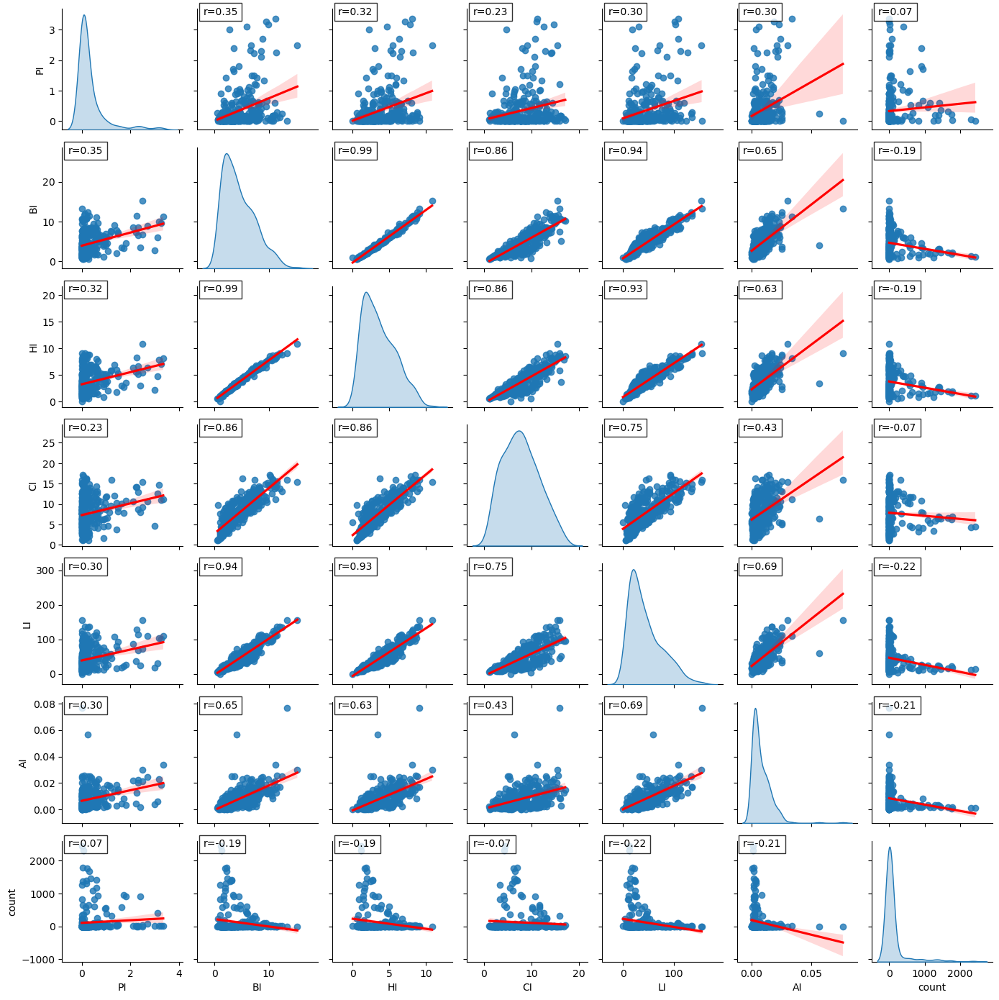

In [170]:
find_corr(week_corr_df_test, columns)

In [171]:
# week_corr_df_test[['PI', 'CI', 'HI', 'BI', 'LI', 'AI', 'count']].corr()

### One week lag correlation

In [172]:
week_corr_df_test['pi_shifted'] = week_corr_df_test['PI'].shift(1)
week_corr_df_test['ci_shifted'] = week_corr_df_test['CI'].shift(1)
week_corr_df_test['hi_shifted'] = week_corr_df_test['HI'].shift(1)
week_corr_df_test['bi_shifted'] = week_corr_df_test['BI'].shift(1)
week_corr_df_test['li_shifted'] = week_corr_df_test['LI'].shift(1)
week_corr_df_test['ai_shifted'] = week_corr_df_test['AI'].shift(1)

In [173]:
week_corr_df_test.head()

,year_start,week_survey,PI,BI,HI,CI,LI,AI,count,pi_shifted,ci_shifted,hi_shifted,bi_shifted,li_shifted,ai_shifted
0,2011,1,0.301471,1.454919,1.235257,2.224750,12.521713,0.002179,5.0,NaN,NaN,NaN,NaN,NaN,NaN
1,2011,2,0.272727,1.813609,1.517173,2.758473,17.173809,0.004446,0.0,0.301471,2.224750,1.235257,1.454919,12.521713,0.002179
2,2011,3,0.288732,1.437606,1.272810,2.649838,13.296923,0.002325,2.0,0.272727,2.758473,1.517173,1.813609,17.173809,0.004446
3,2011,4,0.656716,3.999164,2.916963,6.535306,36.775769,0.005187,1.0,0.288732,2.649838,1.272810,1.437606,13.296923,0.002325
4,2011,5,0.263158,0.556316,0.503684,1.208947,5.125263,0.001026,0.0,0.656716,6.535306,2.916963,3.999164,36.775769,0.005187


In [174]:
week_corr_df_test = week_corr_df_test.dropna(subset=['pi_shifted', 'ci_shifted', 'hi_shifted', 'bi_shifted', 'li_shifted', 'ai_shifted'])

In [175]:
columns = ['pi_shifted', 'ci_shifted', 'hi_shifted', 'bi_shifted', 'li_shifted', 'ai_shifted', 'count']

In [176]:
for col in columns:
    week_corr_df_test[col] = week_corr_df_test[col].astype(float)

/tmp/ipykernel_965/3172157024.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/3172157024.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/3172157024.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_965/317

            pi_shifted  ci_shifted  hi_shifted  bi_shifted  li_shifted  \
pi_shifted    1.000000    0.233738    0.318829    0.347265    0.297373   
ci_shifted    0.233738    1.000000    0.862776    0.856822    0.749897   
hi_shifted    0.318829    0.862776    1.000000    0.993135    0.933157   
bi_shifted    0.347265    0.856822    0.993135    1.000000    0.939844   
li_shifted    0.297373    0.749897    0.933157    0.939844    1.000000   
ai_shifted    0.296800    0.432523    0.626938    0.652047    0.690294   
count         0.105975   -0.029970   -0.157067   -0.154763   -0.208652   

            ai_shifted     count  
pi_shifted    0.296800  0.105975  
ci_shifted    0.432523 -0.029970  
hi_shifted    0.626938 -0.157067  
bi_shifted    0.652047 -0.154763  
li_shifted    0.690294 -0.208652  
ai_shifted    1.000000 -0.196666  
count        -0.196666  1.000000  


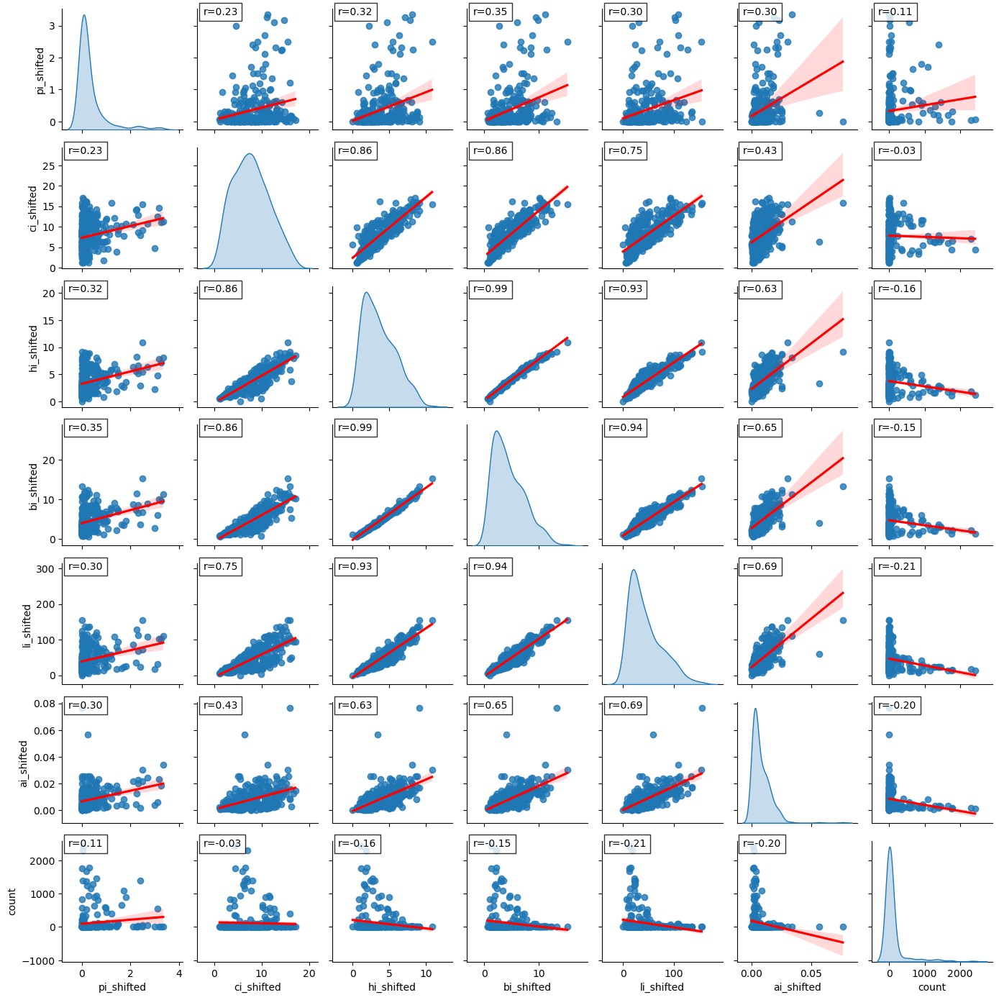

In [177]:
find_corr(week_corr_df_test, columns)

In [178]:
# week_corr_df_test[['pi_shifted', 'ci_shifted', 'hi_shifted', 'bi_shifted', 'li_shifted', 'ai_shifted', 'count']].corr()

---

## EDA of indices and dengue cases

In [179]:
corr_df_test['year_month'] = corr_df_test['year_survey'].astype(str) + '-' + corr_df_test['month_survey'].astype(str).str.zfill(2)

In [180]:
corr_df_test.head()

,year_survey,month_survey,PI,BI,HI,CI,LI,AI,year_infected,month_infected,count,pi_shifted,ci_shifted,hi_shifted,bi_shifted,li_shifted,ai_shifted,year_month
1,2011,2,0.118325,1.065784,0.864028,1.846545,10.181885,0.002040,2011.0,2.0,2.0,0.383178,3.514875,1.712273,2.145727,19.655267,0.003402,2011-02
2,2011,3,0.156551,1.330188,1.160446,2.229359,15.253068,0.003301,NaN,NaN,0.0,0.118325,1.846545,0.864028,1.065784,10.181885,0.002040,2011-03
3,2011,4,0.167640,1.565059,1.345499,2.308219,15.805565,0.006405,NaN,NaN,0.0,0.156551,2.229359,1.160446,1.330188,15.253068,0.003301,2011-04
4,2011,5,0.441250,2.932054,2.420251,3.524541,24.382860,0.008954,NaN,NaN,0.0,0.167640,2.308219,1.345499,1.565059,15.805565,0.006405,2011-05
5,2011,6,0.588032,6.102710,4.761433,7.236904,46.585850,0.017054,NaN,NaN,0.0,0.441250,3.524541,2.420251,2.932054,24.382860,0.008954,2011-06


In [ ]:
# melt the DataFrame to long format
df_long = corr_df_test.melt(id_vars='year_month', value_vars=['CI', 'HI', 'PI', 'BI', 'LI', 'AI'], var_name='Variable', value_name='Value')

fig = px.line(df_long, x='year_month', y='Value', color='Variable', markers=True, title='Entomological indices from 2011 to 2016')
fig.show()

In [196]:
# # melt the DataFrame to long format
# df_long = corr_df_test.melt(id_vars='year_month', value_vars=['ci_shifted', 'hi_shifted', 'pi_shifted', 'bi_shifted', 'li_shifted', 'ai_shifted'], var_name='Variable', value_name='Value')

# fig = px.line(df_long, x='year_month', y='Value', color='Variable', markers=True, title='Interactive Line Plot of Value1 and Value2')
# fig.show()

In [194]:
# melt the DataFrame to long format
df_long = corr_df_test.melt(id_vars='year_month', value_vars=['count'], var_name='Variable', value_name='Value')

# create an interactive line plot
fig = px.line(df_long, x='year_month', y='Value', color='Variable', markers=True, title='Dengue cases trend from 2011 to 2016') 
fig.show()